In [1]:
import sys
import os

# Add the folder that is two levels above the current working directory
project_root = os.path.abspath(os.path.join(os.getcwd(), "..", ".."))
sys.path.append(project_root)


In [2]:
# Standard
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

# Image + ML
import cv2
import tensorflow as tf

# Project utilities
from Pokemon_Core.Image_Module.util import (
    load_augmented, prepare_X_y, compute_class_weights
)
from Pokemon_Core.Image_Module.augmentation import get_augment_data

# For model definition
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input
from tensorflow.keras.models import Model
from tensorflow.keras.utils import to_categorical


In [5]:
import os
import pandas as pd
from Pokemon_Core.Image_Module.util import create_dataset, reduce_side

# --- Step 1: Create the raw dataset (all corners, both sides) ---
df_full = create_dataset()   # This downloads/crops if needed
print("✅ Full dataset:", len(df_full))

# --- Step 2: Reduce/Balance for Left and Right sides ---
df_left = reduce_side(df_full, side='left', reduced_set=500)
df_right = reduce_side(df_full, side='right', reduced_set=500)
print("✅ Reduced left:", len(df_left), "Reduced right:", len(df_right))

# --- Step 3: Save to your desired folder structure ---
base_dir = "../../Data/Processed/Organized_Images"
os.makedirs(os.path.join(base_dir, "Left"), exist_ok=True)
os.makedirs(os.path.join(base_dir, "Right"), exist_ok=True)

left_json = os.path.join(base_dir, "Left", "dict_reduceddataset_left.json")
right_json = os.path.join(base_dir, "Right", "dict_reduceddataset_right.json")

df_left.to_json(left_json)
df_right.to_json(right_json)

print("✅ Saved left to:", left_json)
print("✅ Saved right to:", right_json)


▶️ Processing set dv1 (21 cards)


Set dv1: 100%|██████████| 21/21 [00:01<00:00, 11.48it/s]


▶️ Processing set swsh9 (186 cards)


Set swsh9: 100%|██████████| 186/186 [00:14<00:00, 13.26it/s]


▶️ Processing set swsh45 (73 cards)


Set swsh45: 100%|██████████| 73/73 [00:08<00:00,  9.06it/s]


▶️ Processing set swsh6 (233 cards)


Set swsh6: 100%|██████████| 233/233 [00:18<00:00, 12.63it/s]


▶️ Processing set swsh12pt5 (160 cards)


Set swsh12pt5: 100%|██████████| 160/160 [00:11<00:00, 13.56it/s]


▶️ Processing set xy1 (146 cards)


Set xy1: 100%|██████████| 146/146 [00:12<00:00, 12.16it/s]


▶️ Processing set xy2 (110 cards)


Set xy2: 100%|██████████| 110/110 [00:08<00:00, 13.67it/s]


⚠️ Failed to fetch https://images.pokemontcg.io/xy2/110_hires.png
▶️ Processing set xy3 (114 cards)


Set xy3: 100%|██████████| 114/114 [00:09<00:00, 12.53it/s]


⚠️ Failed to fetch https://images.pokemontcg.io/xy3/114_hires.png
▶️ Processing set g1 (117 cards)


Set g1:  75%|███████▌  | 88/117 [00:06<00:01, 20.88it/s]

⚠️ Failed to fetch https://images.pokemontcg.io/g1/84_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/85_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/86_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/87_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/88_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/89_hires.png


Set g1:  81%|████████  | 95/117 [00:06<00:00, 24.83it/s]

⚠️ Failed to fetch https://images.pokemontcg.io/g1/90_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/91_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/92_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/93_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/94_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/95_hires.png


Set g1:  85%|████████▍ | 99/117 [00:06<00:00, 27.00it/s]

⚠️ Failed to fetch https://images.pokemontcg.io/g1/96_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/97_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/98_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/99_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/100_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/101_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/102_hires.png


Set g1:  91%|█████████▏| 107/117 [00:06<00:00, 29.05it/s]

⚠️ Failed to fetch https://images.pokemontcg.io/g1/103_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/104_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/105_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/106_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/107_hires.png


Set g1:  97%|█████████▋| 113/117 [00:07<00:00, 21.65it/s]

⚠️ Failed to fetch https://images.pokemontcg.io/g1/108_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/109_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/110_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/111_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/112_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/113_hires.png


Set g1: 100%|██████████| 117/117 [00:07<00:00, 15.66it/s]


⚠️ Failed to fetch https://images.pokemontcg.io/g1/114_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/115_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/116_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/g1/117_hires.png
▶️ Processing set xy4 (124 cards)


Set xy4: 100%|██████████| 124/124 [00:09<00:00, 13.44it/s]


⚠️ Failed to fetch https://images.pokemontcg.io/xy4/123_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/xy4/124_hires.png
▶️ Processing set xy6 (112 cards)


Set xy6: 100%|██████████| 112/112 [00:08<00:00, 13.28it/s]


⚠️ Failed to fetch https://images.pokemontcg.io/xy6/111_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/xy6/112_hires.png
▶️ Processing set xy7 (100 cards)


Set xy7: 100%|██████████| 100/100 [00:07<00:00, 12.81it/s]


▶️ Processing set dp1 (130 cards)


Set dp1: 100%|██████████| 130/130 [00:12<00:00, 10.55it/s]


▶️ Processing set dp2 (124 cards)


Set dp2: 100%|██████████| 124/124 [00:11<00:00, 10.98it/s]


▶️ Processing set sm4 (126 cards)


Set sm4: 100%|██████████| 126/126 [00:09<00:00, 12.95it/s]


⚠️ Failed to fetch https://images.pokemontcg.io/sm4/125_hires.png
⚠️ Failed to fetch https://images.pokemontcg.io/sm4/126_hires.png
▶️ Processing set swsh10 (216 cards)


Set swsh10: 100%|██████████| 216/216 [00:15<00:00, 13.99it/s]


▶️ Processing set sv4 (266 cards)


Set sv4: 100%|██████████| 266/266 [01:15<00:00,  3.51it/s]


▶️ Processing set sv3pt5 (207 cards)


Set sv3pt5: 100%|██████████| 207/207 [00:14<00:00, 14.17it/s]


▶️ Processing set sv3 (230 cards)


Set sv3: 100%|██████████| 230/230 [00:17<00:00, 13.27it/s]


▶️ Processing set sv2 (279 cards)


Set sv2: 100%|██████████| 279/279 [00:31<00:00,  8.90it/s]


✅ Full dataset: 6064
Sample count per class for 'left':
set_id
no           500
sv2          279
sv4          266
swsh6        233
sv3          230
swsh10       216
sv3pt5       207
swsh9        186
swsh12pt5    160
sm4          124
swsh45        73
Name: count, dtype: int64
Sample count per class for 'right':
set_id
no     500
xy1    146
dp1    130
dp2    124
xy4    122
xy3    113
xy6    110
xy2    109
xy7    100
g1      83
dv1     21
Name: count, dtype: int64
✅ Reduced left: 2474 Reduced right: 1558
✅ Saved left to: ../../Data/Processed/Organized_Images/Left/dict_reduceddataset_left.json
✅ Saved right to: ../../Data/Processed/Organized_Images/Right/dict_reduceddataset_right.json


In [6]:
# Path to your processed/organized left-corner images
left_path = "../../Data/Processed/Organized_Images/Left/dict_reduceddataset_left.json"
right_path = "../../Data/Processed/Organized_Images/Right/dict_reduceddataset_right.json"

# Load & augment (should output DataFrame with 'corner', 'set_id')
df_aug_left = load_augmented(left_path)
df_aug_right = load_augmented(right_path)

print(df_aug_left.head())
print(df_aug_left['set_id'].value_counts())


Augmenting set no: adding 500 synthetic samples (from 500 base)
Augmenting set sv2: adding 721 synthetic samples (from 279 base)
Augmenting set sv4: adding 734 synthetic samples (from 266 base)
Augmenting set swsh6: adding 767 synthetic samples (from 233 base)
Augmenting set sv3: adding 770 synthetic samples (from 230 base)
Augmenting set swsh10: adding 784 synthetic samples (from 216 base)
Augmenting set sv3pt5: adding 793 synthetic samples (from 207 base)
Augmenting set swsh9: adding 814 synthetic samples (from 186 base)
Augmenting set swsh12pt5: adding 840 synthetic samples (from 160 base)
Augmenting set sm4: adding 876 synthetic samples (from 124 base)
Augmenting set swsh45: adding 927 synthetic samples (from 73 base)
Image shape distribution after augmentation:
 corner
(72, 200, 1)    11000
Name: count, dtype: int64
✅ Loaded & augmented: ../../Data/Processed/Organized_Images/Left/dict_reduceddataset_left.json, samples: 11000
Augmenting set no: adding 500 synthetic samples (from 50

In [56]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dropout, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

import numpy as np
import cv2


# Convert images and labels for modeling
X, y = prepare_X_y(df_aug_left)
le = LabelEncoder()
y_enc = le.fit_transform(y)
y_cat = to_categorical(y_enc)

# Train/val/test split
X_train, X_tmp, y_train, y_tmp = train_test_split(X, y_cat, test_size=0.3, random_state=42, stratify=y_cat)
X_val, X_test, y_val, y_test = train_test_split(X_tmp, y_tmp, test_size=0.5, random_state=42, stratify=y_tmp)

print(X_train.shape, y_train.shape)
print("Num classes:", y_cat.shape[1])

from collections import Counter
print("Train:", Counter(np.argmax(y_train, axis=1)))
print("Val:", Counter(np.argmax(y_val, axis=1)))
print("Test:", Counter(np.argmax(y_test, axis=1)))


(7700, 72, 200, 1) (7700, 11)
Num classes: 11
Train: Counter({7: 700, 1: 700, 10: 700, 3: 700, 4: 700, 2: 700, 6: 700, 9: 700, 8: 700, 0: 700, 5: 700})
Val: Counter({6: 150, 9: 150, 4: 150, 5: 150, 0: 150, 2: 150, 1: 150, 8: 150, 7: 150, 10: 150, 3: 150})
Test: Counter({0: 150, 3: 150, 6: 150, 1: 150, 5: 150, 8: 150, 10: 150, 4: 150, 7: 150, 9: 150, 2: 150})


In [ ]:
IMG_SHAPE = 160

def to_rgb(imgs):
    return np.repeat(imgs, 3, axis=-1)  # (batch, H, W, 1) -> (batch, H, W, 3)

# Convert grayscale to RGB
X_train_rgb = to_rgb(X_train)
X_val_rgb = to_rgb(X_val)
X_test_rgb = to_rgb(X_test)

def resize_imgs(imgs, target_shape=(160, 160)):
    return np.array([cv2.resize(img, target_shape) for img in imgs])

# Resize all images
X_train_resized = resize_imgs(X_train_rgb)
X_val_resized = resize_imgs(X_val_rgb)
X_test_resized = resize_imgs(X_test_rgb)

# -- Build Model --
base_model = MobileNetV2(
    input_shape=(IMG_SHAPE, IMG_SHAPE, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

N = 40  # Number of layers to unfreeze (tune as needed)

for layer in base_model.layers[-N:]:
    if not isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = True

inputs = Input(shape=(IMG_SHAPE, IMG_SHAPE, 3))
x = base_model(inputs, training=False)
x = GlobalAveragePooling2D()(x)
x = Dropout(0.3)(x)
outputs = Dense(y_train.shape[1], activation='softmax')(x)   # Use y_train, not y_cat
model = Model(inputs, outputs)

model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

# -- Training --
early_stop = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)

history_finetune = model.fit(
    X_train_resized, y_train,
    epochs=25,
    batch_size=32,
    validation_data=(X_val_resized, y_val),
    callbacks=[early_stop]
)


Model: "functional_13"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_27 (InputLayer)     │ (None, 160, 160, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_160            │ (None, 5, 5, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d_13     │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_13 (Dropout)            │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 11)             │        14,091 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,272,075 (8.67 MB)

 Trainable params: 1,677,451 (6.40 MB)

 Non-trainable params: 594,624 (2.27 MB)

Epoch 1/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 35s 137ms/step - accuracy: 0.4912 - loss: 1.4235 - val_accuracy: 0.8982 - val_loss: 0.2384
Epoch 2/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 32s 133ms/step - accuracy: 0.9187 - loss: 0.2084 - val_accuracy: 0.9527 - val_loss: 0.1291
Epoch 3/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 34s 141ms/step - accuracy: 0.9687 - loss: 0.0861 - val_accuracy: 0.9424 - val_loss: 0.1392
Epoch 4/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 32s 133ms/step - accuracy: 0.9814 - loss: 0.0518 - val_accuracy: 0.9818 - val_loss: 0.0419
Epoch 5/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 31s 128ms/step - accuracy: 0.9835 - loss: 0.0448 - val_accuracy: 0.9927 - val_loss: 0.0183
Epoch 6/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 34s 139ms/step - accuracy: 0.9949 - loss: 0.0153 - val_accuracy: 0.9952 - val_loss: 0.0162
Epoch 7/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 33s 138ms/step - accuracy: 0.9937 - loss: 0.0217 - val_accuracy: 0.9933 - val_loss: 0.0224
Epoch 8/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 31s 130ms/step - accuracy: 0.9975 - loss: 0

In [54]:
test_loss, test_acc = model.evaluate(X_test_resized, y_test)
print(f"Test accuracy: {test_acc*100:.2f}%")


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 94ms/step - accuracy: 0.9944 - loss: 0.0119
Test accuracy: 99.52%


In [55]:
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np

y_pred = np.argmax(model.predict(X_test_resized), axis=1)
y_true = np.argmax(y_test, axis=1)
print(classification_report(y_true, y_pred))
print(confusion_matrix(y_true, y_pred))

52/52 ━━━━━━━━━━━━━━━━━━━━ 6s 105ms/step
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       150
           1       1.00      1.00      1.00       150
           2       0.97      0.99      0.98       150
           3       1.00      0.99      1.00       150
           4       0.98      1.00      0.99       150
           5       0.99      0.97      0.98       150
           6       1.00      1.00      1.00       150
           7       1.00      1.00      1.00       150
           8       1.00      1.00      1.00       150
           9       1.00      1.00      1.00       150
          10       1.00      1.00      1.00       150

    accuracy                           1.00      1650
   macro avg       1.00      1.00      1.00      1650
weighted avg       1.00      1.00      1.00      1650

[[150   0   0   0   0   0   0   0   0   0   0]
 [  0 150   0   0   0   0   0   0   0   0   0]
 [  0   0 148   0   1   1   0   0   0   0   0]
 [  0

In [51]:
from tensorflow.keras.callbacks import EarlyStopping

early_stop = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)

history_finetune = model.fit(
    X_train_resized, y_train,
    epochs=25,  # Add 10–20 more epochs; stop early if needed!
    batch_size=32,
    validation_data=(X_val_resized, y_val),
    callbacks=[early_stop]
)


Epoch 1/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 38s 148ms/step - accuracy: 0.4803 - loss: 1.4435 - val_accuracy: 0.9133 - val_loss: 0.2287
Epoch 2/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 33s 138ms/step - accuracy: 0.9329 - loss: 0.1768 - val_accuracy: 0.9764 - val_loss: 0.0586
Epoch 3/25
241/241 ━━━━━━━━━━━━━━━━━━━━ 36s 148ms/step - accuracy: 0.9740 - loss: 0.0688 - val_accuracy: 0.9824 - val_loss: 0.0450
Epoch 4/25
105/241 ━━━━━━━━━━━━━━━━━━━━ 15s 118ms/step - accuracy: 0.9932 - loss: 0.0268

KeyboardInterrupt: 

In [38]:
history = model.fit(
    X_train_resized, y_train,
    epochs=10,  # Try small first!
    batch_size=32,
    validation_data=(X_val_resized, y_val)
)

Epoch 1/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 30s 119ms/step - accuracy: 0.3738 - loss: 1.8211 - val_accuracy: 0.7758 - val_loss: 0.7517
Epoch 2/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 27s 113ms/step - accuracy: 0.7101 - loss: 0.8249 - val_accuracy: 0.8218 - val_loss: 0.5517
Epoch 3/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 28s 114ms/step - accuracy: 0.7872 - loss: 0.6178 - val_accuracy: 0.8691 - val_loss: 0.4486
Epoch 4/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 28s 117ms/step - accuracy: 0.8298 - loss: 0.5107 - val_accuracy: 0.8945 - val_loss: 0.3866
Epoch 5/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 28s 116ms/step - accuracy: 0.8554 - loss: 0.4435 - val_accuracy: 0.9048 - val_loss: 0.3504
Epoch 6/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 28s 114ms/step - accuracy: 0.8491 - loss: 0.4243 - val_accuracy: 0.9085 - val_loss: 0.3209
Epoch 7/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 28s 116ms/step - accuracy: 0.8686 - loss: 0.3974 - val_accuracy: 0.8879 - val_loss: 0.3421
Epoch 8/10
241/241 ━━━━━━━━━━━━━━━━━━━━ 27s 114ms/step - accuracy: 0.8759 - loss: 0

In [45]:
test_loss, test_acc = model.evaluate(X_test_resized, y_test)
print(f"Test accuracy: {test_acc*100:.2f}%")


52/52 ━━━━━━━━━━━━━━━━━━━━ 5s 100ms/step - accuracy: 0.9420 - loss: 0.2248
Test accuracy: 94.18%


In [46]:
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np

y_pred = np.argmax(model.predict(X_test_resized), axis=1)
y_true = np.argmax(y_test, axis=1)
print(classification_report(y_true, y_pred))
print(confusion_matrix(y_true, y_pred))


52/52 ━━━━━━━━━━━━━━━━━━━━ 6s 101ms/step
              precision    recall  f1-score   support

           0       1.00      0.99      1.00       150
           1       1.00      1.00      1.00       150
           2       0.86      0.83      0.84       150
           3       0.97      0.92      0.94       150
           4       0.90      0.87      0.89       150
           5       0.77      0.87      0.82       150
           6       0.95      0.95      0.95       150
           7       0.98      0.97      0.98       150
           8       0.99      1.00      0.99       150
           9       0.97      0.96      0.96       150
          10       1.00      0.99      1.00       150

    accuracy                           0.94      1650
   macro avg       0.94      0.94      0.94      1650
weighted avg       0.94      0.94      0.94      1650

[[149   0   0   1   0   0   0   0   0   0   0]
 [  0 150   0   0   0   0   0   0   0   0   0]
 [  0   0 124   1   3  22   0   0   0   0   0]
 [  0

In [10]:
loss, acc = model.evaluate(X_test_rgb, y_test, verbose=0)
print(f"Test accuracy: {acc:.2%}")

# Confusion matrix
from sklearn.metrics import confusion_matrix, classification_report
y_pred = np.argmax(model.predict(X_test_rgb), axis=1)
y_true = np.argmax(y_test, axis=1)
print(classification_report(y_true, y_pred, target_names=le.classes_))


Test accuracy: 87.64%
52/52 ━━━━━━━━━━━━━━━━━━━━ 4s 67ms/step
              precision    recall  f1-score   support

          no       1.00      0.99      1.00       150
         sm4       1.00      1.00      1.00       150
         sv2       0.80      0.65      0.72       150
         sv3       0.83      0.89      0.86       150
      sv3pt5       0.86      0.74      0.80       150
         sv4       0.60      0.77      0.68       150
      swsh10       0.84      0.95      0.89       150
   swsh12pt5       0.87      0.99      0.93       150
      swsh45       0.97      0.99      0.98       150
       swsh6       0.99      0.67      0.80       150
       swsh9       0.98      0.98      0.98       150

    accuracy                           0.88      1650
   macro avg       0.89      0.88      0.88      1650
weighted avg       0.89      0.88      0.88      1650



# SPLIT BEFORE AUGMENTING TO REDUCE DATA LEAKAGE


In [4]:
import pandas as pd
from sklearn.model_selection import train_test_split

# 1. Load your base, un-augmented dataset (left)
base_path = "../../Data/Processed/Organized_Images/Left/dict_reduceddataset_left.json"
df_base = pd.read_json(base_path)

# 2. Stratified split at card/corner level (before augmentation!)
df_train, df_tmp = train_test_split(
    df_base,
    test_size=0.3,
    random_state=42,
    stratify=df_base['set_id']
)
df_val, df_test = train_test_split(
    df_tmp,
    test_size=0.5,
    random_state=42,
    stratify=df_tmp['set_id']
)

# 3. Save splits as temporary JSONs in the same folder
train_path = "../../Data/Processed/Organized_Images/Left/train_unaug_left.json"
val_path   = "../../Data/Processed/Organized_Images/Left/val_unaug_left.json"
test_path  = "../../Data/Processed/Organized_Images/Left/test_unaug_left.json"

df_train.to_json(train_path)
df_val.to_json(val_path)
df_test.to_json(test_path)

print("✅ Split and saved unaugmented train/val/test for LEFT set!")

# 4. Augment each split *from file path*
from Pokemon_Core.Image_Module.augmentation import get_augment_data

df_train_aug = get_augment_data("train_unaug_left.json")
df_val_aug = get_augment_data("val_unaug_left.json")
df_test_aug = get_augment_data("test_unaug_left.json")


✅ Split and saved unaugmented train/val/test for LEFT set!
Augmenting set no: adding 650 synthetic samples (from 350 base)
Augmenting set sv2: adding 805 synthetic samples (from 195 base)
Augmenting set sv4: adding 814 synthetic samples (from 186 base)
Augmenting set swsh6: adding 837 synthetic samples (from 163 base)
Augmenting set sv3: adding 839 synthetic samples (from 161 base)
Augmenting set swsh10: adding 849 synthetic samples (from 151 base)
Augmenting set sv3pt5: adding 855 synthetic samples (from 145 base)
Augmenting set swsh9: adding 870 synthetic samples (from 130 base)
Augmenting set swsh12pt5: adding 888 synthetic samples (from 112 base)
Augmenting set sm4: adding 913 synthetic samples (from 87 base)
Augmenting set swsh45: adding 949 synthetic samples (from 51 base)
Image shape distribution after augmentation:
 corner
(72, 200, 1)    11000
Name: count, dtype: int64
Augmenting set no: adding 925 synthetic samples (from 75 base)
Augmenting set sv2: adding 958 synthetic sampl

In [5]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dropout, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import LabelEncoder
import numpy as np
import cv2

# --- Step 1: Prepare images and labels ---
def prepare_X_y(df, img_key='corner'):
    X = np.stack([np.expand_dims(img, -1) if img.ndim == 2 else img for img in df[img_key].values])
    X = X.astype('float32') / 255.
    y = df['set_id'].values
    return X, y

X_train, y_train = prepare_X_y(df_train_aug)
X_val, y_val     = prepare_X_y(df_val_aug)
X_test, y_test   = prepare_X_y(df_test_aug)

# --- Step 2: Convert grayscale to RGB ---
def to_rgb(imgs):
    return np.repeat(imgs, 3, axis=-1)

X_train_rgb = to_rgb(X_train)
X_val_rgb   = to_rgb(X_val)
X_test_rgb  = to_rgb(X_test)

# --- Step 3: Resize to MobileNetV2 input size (160x160) ---
def resize_imgs(imgs, target_shape=(160, 160)):
    return np.array([cv2.resize(img, target_shape) for img in imgs])

X_train_resized = resize_imgs(X_train_rgb)
X_val_resized   = resize_imgs(X_val_rgb)
X_test_resized  = resize_imgs(X_test_rgb)

# --- Step 4: Encode labels as categorical ---
le = LabelEncoder()
y_train_enc = le.fit_transform(y_train)
y_val_enc   = le.transform(y_val)
y_test_enc  = le.transform(y_test)

from tensorflow.keras.utils import to_categorical
y_train_cat = to_categorical(y_train_enc)
y_val_cat   = to_categorical(y_val_enc)
y_test_cat  = to_categorical(y_test_enc)

# --- Step 5: Build the MobileNetV2 model ---
IMG_SHAPE = 160
base_model = MobileNetV2(
    input_shape=(IMG_SHAPE, IMG_SHAPE, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False

# Unfreeze the last N layers for fine-tuning
N = 30
for layer in base_model.layers[-N:]:
    if not isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = True

inputs = Input(shape=(IMG_SHAPE, IMG_SHAPE, 3))
x = base_model(inputs, training=False)
x = GlobalAveragePooling2D()(x)
x = Dropout(0.3)(x)
outputs = Dense(y_train_cat.shape[1], activation='softmax')(x)
model = Model(inputs, outputs)

model.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

model.summary()

# --- Step 6: Train ---
early_stop = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)

history_finetune = model.fit(
    X_train_resized, y_train_cat,
    epochs=25,
    batch_size=32,
    validation_data=(X_val_resized, y_val_cat),
    callbacks=[early_stop]
)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 160, 160, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ mobilenetv2_1.00_160            │ (None, 5, 5, 1280)     │     2,257,984 │
│ (Functional)                    │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ global_average_pooling2d        │ (None, 1280)           │             0 │
│ (GlobalAveragePooling2D)        │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 1280)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ (None, 11)             │        14,091 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,272,075 (8.67 MB)

 Trainable params: 1,524,811 (5.82 MB)

 Non-trainable params: 747,264 (2.85 MB)

Epoch 1/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 79s 223ms/step - accuracy: 0.5817 - loss: 1.1799 - val_accuracy: 0.9206 - val_loss: 0.2005
Epoch 2/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 69s 201ms/step - accuracy: 0.9491 - loss: 0.1378 - val_accuracy: 0.9651 - val_loss: 0.1012
Epoch 3/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 67s 195ms/step - accuracy: 0.9786 - loss: 0.0602 - val_accuracy: 0.9391 - val_loss: 0.1752
Epoch 4/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 68s 198ms/step - accuracy: 0.9846 - loss: 0.0449 - val_accuracy: 0.9789 - val_loss: 0.0654
Epoch 5/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 81s 236ms/step - accuracy: 0.9860 - loss: 0.0450 - val_accuracy: 0.9491 - val_loss: 0.1911
Epoch 6/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 83s 242ms/step - accuracy: 0.9905 - loss: 0.0292 - val_accuracy: 0.9647 - val_loss: 0.1023
Epoch 7/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 69s 201ms/step - accuracy: 0.9867 - loss: 0.0334 - val_accuracy: 0.9845 - val_loss: 0.0406
Epoch 8/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 76s 222ms/step - accuracy: 0.9963 - loss: 0

In [8]:
print(y_test.shape)  # Should be (num_samples, 11)
print(model.output_shape)  # Should be (None, 11)


(11000,)
(None, 11)


In [9]:
import numpy as np
from tensorflow.keras.utils import to_categorical

# Safety check: convert y_test if needed
if len(y_test.shape) == 1 or y_test.shape[1] == 1:
    y_test = to_categorical(y_test, num_classes=model.output_shape[-1])

# Now safe to evaluate
test_loss, test_acc = model.evaluate(X_test_resized, y_test, verbose=2)
print("Test accuracy: {:.2f}%".format(test_acc * 100))

y_pred = np.argmax(model.predict(X_test_resized), axis=1)
y_true = np.argmax(y_test, axis=1)

from sklearn.metrics import classification_report, confusion_matrix
print(classification_report(y_true, y_pred))
print(confusion_matrix(y_true, y_pred))


ValueError: invalid literal for int() with base 10: 'no'

In [10]:
# Fix y_test before evaluating
y_test_enc = le.transform(y_test)
y_test_cat = to_categorical(y_test_enc, num_classes=len(le.classes_))
test_loss, test_acc = model.evaluate(X_test_resized, y_test_cat, verbose=2)


344/344 - 31s - 89ms/step - accuracy: 0.9901 - loss: 0.0321


In [12]:
from sklearn.metrics import classification_report, confusion_matrix

# Predict
y_pred_prob = model.predict(X_test_resized)
y_pred_idx = np.argmax(y_pred_prob, axis=1)
y_true_idx = np.argmax(y_test_cat, axis=1)

# Labels for human-readable output
y_pred_labels = le.inverse_transform(y_pred_idx)
y_true_labels = le.inverse_transform(y_true_idx)

# Print reports
print(classification_report(y_true_labels, y_pred_labels))
print(confusion_matrix(y_true_labels, y_pred_labels))


344/344 ━━━━━━━━━━━━━━━━━━━━ 43s 124ms/step
              precision    recall  f1-score   support

          no       1.00      1.00      1.00      1000
         sm4       1.00      1.00      1.00      1000
         sv2       0.99      0.96      0.97      1000
         sv3       1.00      0.99      1.00      1000
      sv3pt5       1.00      0.98      0.99      1000
         sv4       0.94      0.99      0.96      1000
      swsh10       0.99      0.99      0.99      1000
   swsh12pt5       0.98      0.99      0.99      1000
      swsh45       1.00      1.00      1.00      1000
       swsh6       1.00      1.00      1.00      1000
       swsh9       1.00      1.00      1.00      1000

    accuracy                           0.99     11000
   macro avg       0.99      0.99      0.99     11000
weighted avg       0.99      0.99      0.99     11000

[[1000    0    0    0    0    0    0    0    0    0    0]
 [   0 1000    0    0    0    0    0    0    0    0    0]
 [   0    0  958    0    0 

In [14]:
import pandas as pd

# Load your unaugmented dataset
df_base = pd.read_json("../../Data/Processed/Organized_Images/Left/dict_reduceddataset_left.json")

# Reload the splits you actually used (should be saved from your previous split step)
df_train = pd.read_json("../../Data/Processed/Organized_Images/Left/train_unaug_left.json")
df_val   = pd.read_json("../../Data/Processed/Organized_Images/Left/val_unaug_left.json")
df_test  = pd.read_json("../../Data/Processed/Organized_Images/Left/test_unaug_left.json")

# 1. Check for ID overlap between splits
# We'll use the DataFrame index as the image ID if no column exists
def check_overlap(df1, df2, name1="df1", name2="df2"):
    overlap = set(df1.index).intersection(set(df2.index))
    print(f"Overlap between {name1} and {name2}: {len(overlap)}")

print("=== Checking for overlap between splits ===")
check_overlap(df_train, df_val, "train", "val")
check_overlap(df_train, df_test, "train", "test")
check_overlap(df_val, df_test, "val", "test")

# 2. Show the class distribution in each split
print("\n=== Class distribution in train ===")
print(df_train['set_id'].value_counts())
print("\n=== Class distribution in val ===")
print(df_val['set_id'].value_counts())
print("\n=== Class distribution in test ===")
print(df_test['set_id'].value_counts())

# 3. For further robustness: check the total number of unique IDs across all splits
total_unique = len(set(df_train.index) | set(df_val.index) | set(df_test.index))
print(f"\nTotal unique cards across all splits: {total_unique} (should equal df_base rows: {len(df_base)})")

# 4. Optional: If you have an explicit 'image_id' column, use that instead of index everywhere above.


=== Checking for overlap between splits ===
Overlap between train and val: 0
Overlap between train and test: 0
Overlap between val and test: 0

=== Class distribution in train ===
set_id
no           350
sv2          195
sv4          186
swsh6        163
sv3          161
swsh10       151
sv3pt5       145
swsh9        130
swsh12pt5    112
sm4           87
swsh45        51
Name: count, dtype: int64

=== Class distribution in val ===
set_id
no           75
sv2          42
sv4          40
swsh6        35
sv3          34
swsh10       32
sv3pt5       31
swsh9        28
swsh12pt5    24
sm4          19
swsh45       11
Name: count, dtype: int64

=== Class distribution in test ===
set_id
no           75
sv2          42
sv4          40
sv3          35
swsh6        35
swsh10       33
sv3pt5       31
swsh9        28
swsh12pt5    24
sm4          18
swsh45       11
Name: count, dtype: int64

Total unique cards across all splits: 2474 (should equal df_base rows: 2474)


In [15]:
import os
import pickle

# Path to your left directory
left_dir = "../../Data/Processed/Organized_Images/Left/"

# Save model
model_path = os.path.join(left_dir, "mobilenet_left_model.h5")
model.save(model_path)

# Save label encoder
encoder_path = os.path.join(left_dir, "le_left.pkl")
with open(encoder_path, "wb") as f:
    pickle.dump(le, f)

print(f"✅ Model saved to: {model_path}")
print(f"✅ Label encoder saved to: {encoder_path}")


✅ Model saved to: ../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5
✅ Label encoder saved to: ../../Data/Processed/Organized_Images/Left/le_left.pkl


# now we do right side

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split

# Load unaugmented right side data
df_base_right = pd.read_json("../../Data/Processed/Organized_Images/Right/dict_reduceddataset_right.json")

# Stratified split (before augmentation)
df_train_right, df_tmp_right = train_test_split(df_base_right, test_size=0.3, random_state=42, stratify=df_base_right['set_id'])
df_val_right, df_test_right = train_test_split(df_tmp_right, test_size=0.5, random_state=42, stratify=df_tmp_right['set_id'])

# Save if you want, e.g.:
df_train_right.to_json("../../Data/Processed/Organized_Images/Right/train_unaug_right.json")
df_val_right.to_json("../../Data/Processed/Organized_Images/Right/val_unaug_right.json")
df_test_right.to_json("../../Data/Processed/Organized_Images/Right/test_unaug_right.json")


from Pokemon_Core.Image_Module.augmentation import get_augment_data


df_train_right_aug = get_augment_data("../../Data/Processed/Organized_Images/Right/train_unaug_right.json")
df_val_right_aug   = get_augment_data("../../Data/Processed/Organized_Images/Right/val_unaug_right.json")
df_test_right_aug  = get_augment_data("../../Data/Processed/Organized_Images/Right/test_unaug_right.json")


Augmenting set no: adding 650 synthetic samples (from 350 base)
Augmenting set xy1: adding 898 synthetic samples (from 102 base)
Augmenting set dp1: adding 909 synthetic samples (from 91 base)
Augmenting set dp2: adding 913 synthetic samples (from 87 base)
Augmenting set xy4: adding 915 synthetic samples (from 85 base)
Augmenting set xy3: adding 921 synthetic samples (from 79 base)
Augmenting set xy6: adding 923 synthetic samples (from 77 base)
Augmenting set xy2: adding 924 synthetic samples (from 76 base)
Augmenting set xy7: adding 930 synthetic samples (from 70 base)
Augmenting set g1: adding 942 synthetic samples (from 58 base)
Augmenting set dv1: adding 985 synthetic samples (from 15 base)
Image shape distribution after augmentation:
 corner
(72, 200, 1)    11000
Name: count, dtype: int64
Augmenting set no: adding 925 synthetic samples (from 75 base)
Augmenting set xy1: adding 978 synthetic samples (from 22 base)
Augmenting set dp1: adding 980 synthetic samples (from 20 base)
Augm

In [5]:
from sklearn.preprocessing import LabelEncoder
from tensorflow.keras.utils import to_categorical

def prepare_X_y(df, img_key='corner'):
    X = np.stack([np.expand_dims(img, -1) if img.ndim == 2 else img for img in df[img_key].values])
    X = X.astype('float32') / 255.
    y = df['set_id'].values
    return X, y

X_train_r, y_train_r = prepare_X_y(df_train_right_aug)
X_val_r, y_val_r = prepare_X_y(df_val_right_aug)
X_test_r, y_test_r = prepare_X_y(df_test_right_aug)

le_right = LabelEncoder()
y_train_r_enc = le_right.fit_transform(y_train_r)
y_val_r_enc = le_right.transform(y_val_r)
y_test_r_enc = le_right.transform(y_test_r)

y_train_r_cat = to_categorical(y_train_r_enc)
y_val_r_cat = to_categorical(y_val_r_enc)
y_test_r_cat = to_categorical(y_test_r_enc)

In [6]:
def to_rgb(imgs):
    return np.repeat(imgs, 3, axis=-1)

def resize_imgs(imgs, target_shape=(160, 160)):
    return np.array([cv2.resize(img, target_shape) for img in imgs])

X_train_r_rgb = to_rgb(X_train_r)
X_val_r_rgb = to_rgb(X_val_r)
X_test_r_rgb = to_rgb(X_test_r)

X_train_r_resized = resize_imgs(X_train_r_rgb)
X_val_r_resized = resize_imgs(X_val_r_rgb)
X_test_r_resized = resize_imgs(X_test_r_rgb)


In [7]:
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dropout, Dense
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping

IMG_SHAPE = 160
N = 30  # or whatever N you liked best last time

base_model = MobileNetV2(
    input_shape=(IMG_SHAPE, IMG_SHAPE, 3),
    include_top=False,
    weights='imagenet'
)
base_model.trainable = False
for layer in base_model.layers[-N:]:
    if not isinstance(layer, tf.keras.layers.BatchNormalization):
        layer.trainable = True

inputs = Input(shape=(IMG_SHAPE, IMG_SHAPE, 3))
x = base_model(inputs, training=False)
x = GlobalAveragePooling2D()(x)
x = Dropout(0.3)(x)
outputs = Dense(y_train_r_cat.shape[1], activation='softmax')(x)
model_right = Model(inputs, outputs)

model_right.compile(
    optimizer=Adam(learning_rate=1e-4),
    loss='categorical_crossentropy',
    metrics=['accuracy']
)

early_stop = EarlyStopping(monitor="val_loss", patience=5, restore_best_weights=True)

history_right = model_right.fit(
    X_train_r_resized, y_train_r_cat,
    epochs=25,
    batch_size=32,
    validation_data=(X_val_r_resized, y_val_r_cat),
    callbacks=[early_stop]
)


Epoch 1/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 80s 226ms/step - accuracy: 0.6227 - loss: 1.0963 - val_accuracy: 0.9301 - val_loss: 0.2051
Epoch 2/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 77s 224ms/step - accuracy: 0.9919 - loss: 0.0309 - val_accuracy: 0.9486 - val_loss: 0.1772
Epoch 3/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 69s 199ms/step - accuracy: 0.9979 - loss: 0.0088 - val_accuracy: 0.9523 - val_loss: 0.1722
Epoch 4/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 67s 194ms/step - accuracy: 0.9982 - loss: 0.0062 - val_accuracy: 0.9590 - val_loss: 0.2018
Epoch 5/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 66s 193ms/step - accuracy: 0.9994 - loss: 0.0029 - val_accuracy: 0.9568 - val_loss: 0.1699
Epoch 6/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 66s 191ms/step - accuracy: 0.9930 - loss: 0.0255 - val_accuracy: 0.9536 - val_loss: 0.2571
Epoch 7/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 73s 214ms/step - accuracy: 1.0000 - loss: 3.3634e-04 - val_accuracy: 0.9554 - val_loss: 0.3237
Epoch 8/25
344/344 ━━━━━━━━━━━━━━━━━━━━ 72s 209ms/step - accuracy: 0.9977 - los

In [8]:
test_loss_r, test_acc_r = model_right.evaluate(X_test_r_resized, y_test_r_cat, verbose=2)
print("Test accuracy: {:.2f}%".format(test_acc_r * 100))

# Classification report & confusion matrix
y_pred_r = np.argmax(model_right.predict(X_test_r_resized), axis=1)
y_true_r = np.argmax(y_test_r_cat, axis=1)

from sklearn.metrics import classification_report, confusion_matrix

print(classification_report(y_true_r, y_pred_r, target_names=le_right.classes_))
print(confusion_matrix(y_true_r, y_pred_r))


344/344 - 34s - 100ms/step - accuracy: 0.9771 - loss: 0.0763
Test accuracy: 97.71%
344/344 ━━━━━━━━━━━━━━━━━━━━ 35s 101ms/step
              precision    recall  f1-score   support

         dp1       1.00      1.00      1.00      1000
         dp2       1.00      1.00      1.00      1000
         dv1       0.99      1.00      0.99      1000
          g1       1.00      0.93      0.96      1000
          no       1.00      1.00      1.00      1000
         xy1       0.99      0.95      0.97      1000
         xy2       0.93      1.00      0.96      1000
         xy3       1.00      0.97      0.98      1000
         xy4       0.96      1.00      0.98      1000
         xy6       0.90      0.92      0.91      1000
         xy7       1.00      0.99      0.99      1000

    accuracy                           0.98     11000
   macro avg       0.98      0.98      0.98     11000
weighted avg       0.98      0.98      0.98     11000

[[1000    0    0    0    0    0    0    0    0    0    0]
 [

In [3]:
import os
import pickle

right_dir = "../../Data/Processed/Organized_Images/Right/"
model_path_r = os.path.join(right_dir, "mobilenet_right_model.h5")
encoder_path_r = os.path.join(right_dir, "le_right.pkl")

model_right.save(model_path_r)
with open(encoder_path_r, "wb") as f:
    pickle.dump(le_right, f)


NameError: name 'model_right' is not defined

In [3]:
import os
import pickle
from tensorflow.keras.models import load_model

# Update these paths as needed!
model_path_left = "../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5"
encoder_path_left = "../../Data/Processed/Organized_Images/Left/le_left.pkl"

model_left = load_model(model_path_left)
with open(encoder_path_left, "rb") as f:
    le_left = pickle.load(f)


In [4]:
import cv2
import numpy as np

def preprocess_for_mobilenet(img_path):
    img = cv2.imread(img_path, cv2.IMREAD_GRAYSCALE)
    img = cv2.resize(img, (160, 160))
    img = img.astype('float32') / 255.0
    img = np.expand_dims(img, axis=-1)        # (160, 160, 1)
    img = np.repeat(img, 3, axis=-1)          # (160, 160, 3)
    img = np.expand_dims(img, axis=0)         # (1, 160, 160, 3)
    return img


In [4]:
from PIL import Image
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg

img_path = "../../images_example/IMG_9401.jpg"

# 1. Load and align the card (if needed)
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)  # Your custom function

# 2. Extract symbol region (bottom left/right)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Pick the left or right region and convert to format for model:
# Example for left:
region = graybottomleft  # or graybottomright
region = np.squeeze(region)           # (72, 200) or (72, 200, 1)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]           # (72, 200)
region = cv2.resize(region, (160, 160))
print(region.min(), region.max())
region = np.expand_dims(region, axis=-1)   # (160, 160, 1)
region = np.repeat(region, 3, axis=-1)     # (160, 160, 3) for MobileNet
region = np.expand_dims(region, axis=0)    # (1, 160, 160, 3) for prediction


0.049632356 0.8356005


In [5]:
# Load your trained model and label encoder (adjust path as needed)
from tensorflow.keras.models import load_model
import pickle

model_left = load_model("../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5")
with open("../../Data/Processed/Organized_Images/Left/le_left.pkl", "rb") as f:
    le_left = pickle.load(f)

# Predict!
probs = model_left.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_left.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 394ms/step
Predicted card set: swsh45 (probability: 1.00)


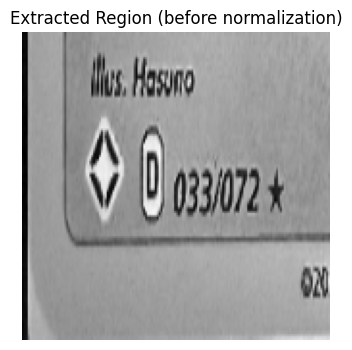

In [6]:
import matplotlib.pyplot as plt

# BEFORE normalization and channel repetition!
plt.figure(figsize=(4,4))
plt.title("Extracted Region (before normalization)")
plt.imshow(np.squeeze(region)[...,0], cmap='gray')
plt.axis('off')
plt.show()

In [25]:
print(region.shape, region.dtype, region.min(), region.max())


(1, 160, 160, 3) float32 0.00019463668 0.0032768648


In [28]:
print(le_right.classes_)

['dp1' 'dp2' 'dv1' 'g1' 'no' 'xy1' 'xy2' 'xy3' 'xy4' 'xy6' 'xy7']


In [26]:
print(le_left.classes_)  # List of all set_ids in correct order

['no' 'sm4' 'sv2' 'sv3' 'sv3pt5' 'sv4' 'swsh10' 'swsh12pt5' 'swsh45'
 'swsh6' 'swsh9']


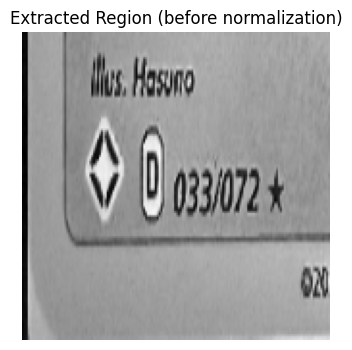

In [7]:
import matplotlib.pyplot as plt

# BEFORE normalization and channel repetition!
plt.figure(figsize=(4,4))
plt.title("Extracted Region (before normalization)")
plt.imshow(np.squeeze(region)[...,0], cmap='gray')
plt.axis('off')
plt.show()


In [8]:
from PIL import Image
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg

img_path = "../../images_example/IMG_9402.jpg"

# 1. Load and align the card (if needed)
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)  # Your custom function

# 2. Extract symbol region (bottom left/right)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Pick the left or right region and convert to format for model:
# Example for left:
region = graybottomleft  # or graybottomright
region = np.squeeze(region)           # (72, 200) or (72, 200, 1)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]           # (72, 200)
region = cv2.resize(region, (160, 160))
print(region.min(), region.max())
region = np.expand_dims(region, axis=-1)   # (160, 160, 1)
region = np.repeat(region, 3, axis=-1)     # (160, 160, 3) for MobileNet
region = np.expand_dims(region, axis=0)    # (1, 160, 160, 3) for prediction


0.008161774 0.96068627


In [9]:
#check right sided identifier
# Load your trained model and label encoder (adjust path as needed)
from tensorflow.keras.models import load_model
import pickle

model_right = load_model("../../Data/Processed/Organized_Images/Right/mobilenet_right_model.h5")
with open("../../Data/Processed/Organized_Images/Right/le_right.pkl", "rb") as f:
    le_right = pickle.load(f)

# Predict!
probs = model_right.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_right.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 356ms/step
Predicted card set: dp1 (probability: 0.45)


In [10]:
from PIL import Image
import numpy as np
import cv2
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg

# Load your trained right model and encoder if not already loaded
# from tensorflow.keras.models import load_model
import pickle
model_right = load_model("../../Data/Processed/Organized_Images/Right/mobilenet_right_model.h5")
with open("../../Data/Processed/Organized_Images/Right/le_right.pkl", "rb") as f:
    le_right = pickle.load(f)

img_path = "../../images_example/IMG_9418.jpg"  # Replace with your own

# 1. Load and align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# 2. Extract symbol region (right)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Preprocess right region for the model
region = graybottomright
region = np.squeeze(region)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]
region = cv2.resize(region, (160, 160))
region = region.astype('float32')  # <-- DO NOT divide by 255!
region = np.expand_dims(region, axis=-1)
region = np.repeat(region, 3, axis=-1)
region = np.expand_dims(region, axis=0)  # (1, 160, 160, 3)

# 4. Predict
# Predict!
probs = model_right.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_right.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 360ms/step
Predicted card set: xy2 (probability: 1.00)


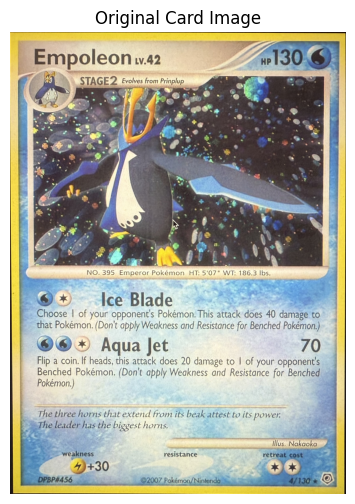

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step
Predicted card set: dp1 (probability: 1.00)


In [11]:
from PIL import Image
import numpy as np
import cv2
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
import matplotlib.pyplot as plt

# Load your trained right model and encoder if not already loaded
from tensorflow.keras.models import load_model
import pickle

model_right = load_model("../../Data/Processed/Organized_Images/Right/mobilenet_right_model.h5")
with open("../../Data/Processed/Organized_Images/Right/le_right.pkl", "rb") as f:
    le_right = pickle.load(f)

img_path = "../../images_example/IMG_9417.jpg"  # Replace with your own

# 1. Load and align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# --- SHOW THE ORIGINAL CARD IMAGE ---
plt.figure(figsize=(6, 6))
plt.imshow(aligned_img)
plt.axis("off")
plt.title("Original Card Image")
plt.show()


# 2. Extract symbol region (right)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Preprocess right region for the model
region = graybottomright
region = np.squeeze(region)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]
region = cv2.resize(region, (160, 160))
region = region.astype('float32')  # <-- DO NOT divide by 255!
region = np.expand_dims(region, axis=-1)
region = np.repeat(region, 3, axis=-1)
region = np.expand_dims(region, axis=0)  # (1, 160, 160, 3)

# 4. Predict
probs = model_right.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_right.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


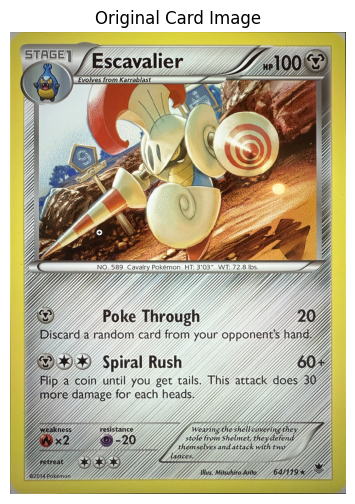

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
Predicted card set: xy4 (probability: 0.52)


In [12]:
from PIL import Image
import numpy as np
import cv2
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
import matplotlib.pyplot as plt

# Load your trained right model and encoder if not already loaded
from tensorflow.keras.models import load_model
import pickle

model_right = load_model("../../Data/Processed/Organized_Images/Right/mobilenet_right_model.h5")
with open("../../Data/Processed/Organized_Images/Right/le_right.pkl", "rb") as f:
    le_right = pickle.load(f)

img_path = "../../images_example/IMG_9400.jpg"  # Replace with your own

# 1. Load and align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# --- SHOW THE ORIGINAL CARD IMAGE ---
plt.figure(figsize=(6, 6))
plt.imshow(aligned_img)
plt.axis("off")
plt.title("Original Card Image")
plt.show()


# 2. Extract symbol region (right)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Preprocess right region for the model
region = graybottomright
region = np.squeeze(region)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]
region = cv2.resize(region, (160, 160))
region = region.astype('float32')  # <-- DO NOT divide by 255!
region = np.expand_dims(region, axis=-1)
region = np.repeat(region, 3, axis=-1)
region = np.expand_dims(region, axis=0)  # (1, 160, 160, 3)

# 4. Predict
probs = model_right.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_right.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


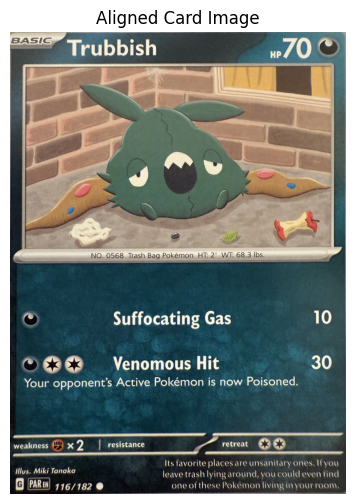

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 654ms/step
Predicted card set: sv3 (probability: 0.36)


In [13]:
from PIL import Image
import numpy as np
import cv2
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
import matplotlib.pyplot as plt

from tensorflow.keras.models import load_model
import pickle

# === Load LEFT model and encoder ===
model_left = load_model("../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5")
with open("../../Data/Processed/Organized_Images/Left/le_left.pkl", "rb") as f:
    le_left = pickle.load(f)

img_path = "../../images_example/IMG_9429.jpg"  # Replace with your own

# 1. Load and align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# --- SHOW THE ALIGNED CARD IMAGE ---
plt.figure(figsize=(6, 6))
plt.imshow(aligned_img)
plt.axis("off")
plt.title("Aligned Card Image")
plt.show()

# 2. Extract symbol region (left)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Preprocess left region for the model
region = graybottomleft
region = np.squeeze(region)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]
region = cv2.resize(region, (160, 160))
region = region.astype('float32')  # <-- DO NOT divide by 255!
region = np.expand_dims(region, axis=-1)
region = np.repeat(region, 3, axis=-1)
region = np.expand_dims(region, axis=0)  # (1, 160, 160, 3)

# 4. Predict
probs = model_left.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_left.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


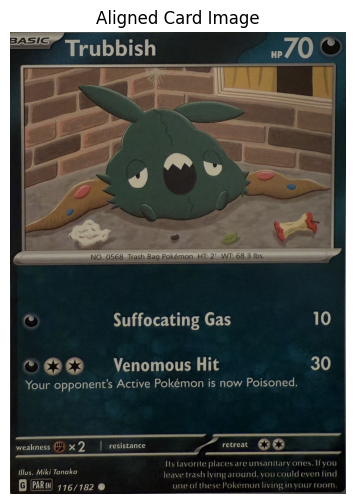

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 393ms/step
Predicted card set: no (probability: 0.64)


In [14]:
from PIL import Image
import numpy as np
import cv2
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
import matplotlib.pyplot as plt

from tensorflow.keras.models import load_model
import pickle

# === Load LEFT model and encoder ===
model_left = load_model("../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5")
with open("../../Data/Processed/Organized_Images/Left/le_left.pkl", "rb") as f:
    le_left = pickle.load(f)

img_path = "../../images_example/IMG_9410.jpg"  # Replace with your own

# 1. Load and align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# --- SHOW THE ALIGNED CARD IMAGE ---
plt.figure(figsize=(6, 6))
plt.imshow(aligned_img)
plt.axis("off")
plt.title("Aligned Card Image")
plt.show()

# 2. Extract symbol region (left)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Preprocess left region for the model
region = graybottomleft
region = np.squeeze(region)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]
region = cv2.resize(region, (160, 160))
region = region.astype('float32')  # <-- DO NOT divide by 255!
region = np.expand_dims(region, axis=-1)
region = np.repeat(region, 3, axis=-1)
region = np.expand_dims(region, axis=0)  # (1, 160, 160, 3)

# 4. Predict
probs = model_left.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_left.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


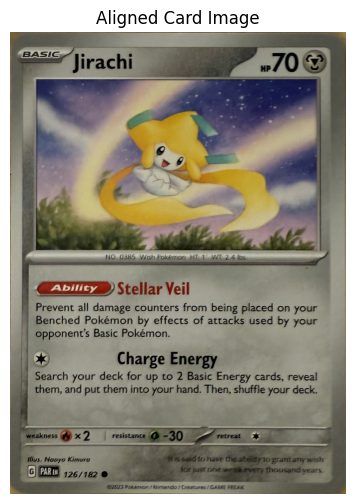

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 455ms/step
Predicted card set: sv4 (probability: 0.86)


In [15]:
from PIL import Image
import numpy as np
import cv2
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
import matplotlib.pyplot as plt

from tensorflow.keras.models import load_model
import pickle

# === Load LEFT model and encoder ===
model_left = load_model("../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5")
with open("../../Data/Processed/Organized_Images/Left/le_left.pkl", "rb") as f:
    le_left = pickle.load(f)

img_path = "../../images_example/IMG_9437.jpg"  # Replace with your own

# 1. Load and align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# --- SHOW THE ALIGNED CARD IMAGE ---
plt.figure(figsize=(6, 6))
plt.imshow(aligned_img)
plt.axis("off")
plt.title("Aligned Card Image")
plt.show()

# 2. Extract symbol region (left)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Preprocess left region for the model
region = graybottomleft
region = np.squeeze(region)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]
region = cv2.resize(region, (160, 160))
region = region.astype('float32')  # <-- DO NOT divide by 255!
region = np.expand_dims(region, axis=-1)
region = np.repeat(region, 3, axis=-1)
region = np.expand_dims(region, axis=0)  # (1, 160, 160, 3)

# 4. Predict
probs = model_left.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_left.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


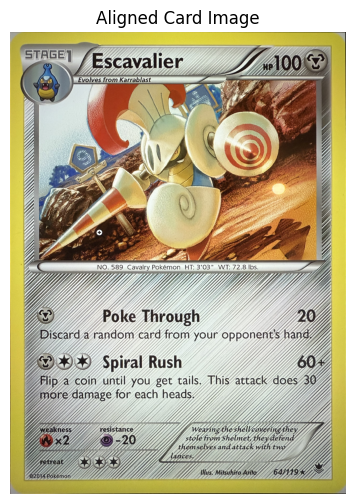

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 411ms/step
Predicted card set: no (probability: 1.00)


In [16]:
from PIL import Image
import numpy as np
import cv2
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
import matplotlib.pyplot as plt

from tensorflow.keras.models import load_model
import pickle

# === Load LEFT model and encoder ===
model_left = load_model("../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5")
with open("../../Data/Processed/Organized_Images/Left/le_left.pkl", "rb") as f:
    le_left = pickle.load(f)

img_path = "../../images_example/IMG_9400.jpg"  # Replace with your own

# 1. Load and align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# --- SHOW THE ALIGNED CARD IMAGE ---
plt.figure(figsize=(6, 6))
plt.imshow(aligned_img)
plt.axis("off")
plt.title("Aligned Card Image")
plt.show()

# 2. Extract symbol region (left)
graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

# 3. Preprocess left region for the model
region = graybottomleft
region = np.squeeze(region)
if region.ndim == 3 and region.shape[-1] == 1:
    region = region[..., 0]
region = cv2.resize(region, (160, 160))
region = region.astype('float32')  # <-- DO NOT divide by 255!
region = np.expand_dims(region, axis=-1)
region = np.repeat(region, 3, axis=-1)
region = np.expand_dims(region, axis=0)  # (1, 160, 160, 3)

# 4. Predict
probs = model_left.predict(region)
pred_class_idx = np.argmax(probs, axis=1)[0]
pred_class = le_left.inverse_transform([pred_class_idx])[0]

print(f"Predicted card set: {pred_class} (probability: {probs[0][pred_class_idx]:.2f})")


# CHECK COMBINED PIPELINE WITH DEFORMER, CARDNR EXTRACTOR AND SET ID TRAINED IDENTIFIER

In [17]:
import numpy as np
import cv2
from PIL import Image
import matplotlib.pyplot as plt
import pickle

from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
from Pokemon_Core.Image_Module.text_detection import get_pokeid
from Pokemon_Core.Image_Module.prediction import get_card_info

# --- Load models and encoders ---
from tensorflow.keras.models import load_model

left_model_path = "../../Data/Processed/Organized_Images/Left/mobilenet_left_model.h5"
right_model_path = "../../Data/Processed/Organized_Images/Right/mobilenet_right_model.h5"
with open("../../Data/Processed/Organized_Images/Left/le_left.pkl", "rb") as f:
    le_left = pickle.load(f)
with open("../../Data/Processed/Organized_Images/Right/le_right.pkl", "rb") as f:
    le_right = pickle.load(f)
model_left = load_model(left_model_path)
model_right = load_model(right_model_path)

def predict_card_set(img_path, debug=True):
    """Predicts set from left and right; returns set_id and side."""
    pil_img = Image.open(img_path).convert("RGB")
    aligned_img = deform_card(pil_img)
    if debug:
        plt.imshow(aligned_img)
        plt.axis("off")
        plt.title("Aligned Card")
        plt.show()
    # Extract left/right symbol crops
    grayleft, grayright = card_prediction_processing(aligned_img, cfg)
    # Preprocess for model
    def prep(region):
        region = np.squeeze(region)
        if region.ndim == 3 and region.shape[-1] == 1:
            region = region[..., 0]
        region = cv2.resize(region, (160, 160))
        region = region.astype('float32')
        region = np.expand_dims(region, axis=-1)
        region = np.repeat(region, 3, axis=-1)
        region = np.expand_dims(region, axis=0)
        return region

    left_input = prep(grayleft)
    right_input = prep(grayright)

    pred_left = model_left.predict(left_input)
    pred_right = model_right.predict(right_input)

    set_left = le_left.inverse_transform([np.argmax(pred_left)])[0]
    set_right = le_right.inverse_transform([np.argmax(pred_right)])[0]

    # --- Decide which set to use (and side) ---
    if set_right == 'no' and set_left == 'no':
        print("❌ No set detected. Try another image.")
        return None, None, aligned_img
    elif set_right != 'no' and set_left != 'no':
        # Both sides predict a real set, maybe ask user or pick highest confidence
        print(f"⚠️ Both sides predict sets: LEFT={set_left} ({pred_left.max():.2f}), RIGHT={set_right} ({pred_right.max():.2f})")
        side = "left" if pred_left.max() > pred_right.max() else "right"
        set_id = set_left if side == "left" else set_right
    elif set_right == 'no':
        set_id, side = set_left, "left"
    elif set_left == 'no':
        set_id, side = set_right, "right"

    if debug:
        print(f"✅ Predicted set: {set_id} (side: {side})")
    return set_id, side, aligned_img

def predict_card(img_path, debug=True):
    set_id, side, aligned_img = predict_card_set(img_path, debug=debug)
    if set_id is None:
        return None

    # --- Crop and OCR the number ---
    card_img_np = np.array(aligned_img)
    pokeid = get_pokeid(card_img_np, set_id)
    if debug:
        print(f"🔎 OCR’d card number: {pokeid}")

    # --- Fetch card info ---
    info = get_card_info(set_id, pokeid)
    if info is None or info[0] is None:
        print("⚠️ Card not found in API.")
        rarity = market_price = image_url = None
    else:
        rarity, market_price, image_url = info
        if debug:
            print(f"Rarity: {rarity}\nAvg. Price: {market_price}\nImage: {image_url}")

    # --- Display results ---
    if debug:
        plt.imshow(aligned_img)
        plt.axis("off")
        plt.title(f"Detected: {set_id}-{pokeid}")
        plt.show()
    return {
        "set_id": set_id,
        "pokeid": pokeid,
        "rarity": rarity,
        "market_price": market_price,
        "image_url": image_url
    }


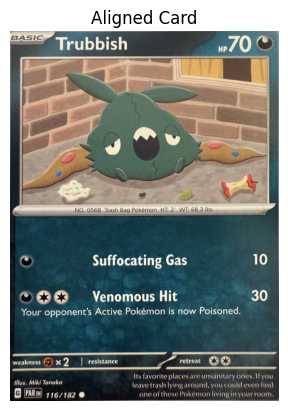

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 381ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 364ms/step
✅ Predicted set: sv3 (side: left)
[Reference OCR rejected] Set=sv3, ID=


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


DEBUG: EasyOCR raw: [([[75, 0], [135, 0], [135, 77], [75, 77]], '6', 0.9993630470162316), ([[181, 0], [400, 0], [400, 99], [181, 99]], '38', 0.38390676992005013)]
DEBUG: Candidate: 6 Conf: 0.9993630470162316
DEBUG: Candidate: 38 Conf: 0.38390676992005013
DEBUG: Fallback runs: ['638']
DEBUG: Longest run fallback: 638
[Fallback OCR succeeded] Set=sv3, ID=638
🔎 OCR’d card number: 638


HTTPError: 404 Client Error: Not Found for url: https://api.pokemontcg.io/v2/cards/sv3-638

In [18]:
# ---- Usage example ----
img_path = "../../images_example/IMG_9429.jpg"
result = predict_card(img_path, debug=True)
print(result)


In [16]:
import matplotlib.pyplot as plt
from Pokemon_Core.Image_Module.text_detection import get_id_coords

def visualize_id_crop(card_img, set_id):
    # If your card is not 600x825, resize to standard
    img = cv2.resize(card_img, (600, 825))
    a, b, c, d = get_id_coords(set_id, img.shape)
    # Draw rectangle on a copy for visualization
    vis_img = img.copy()
    cv2.rectangle(vis_img, (a, b), (c, d), (255,0,0), 3)
    plt.figure(figsize=(8, 8))
    plt.imshow(cv2.cvtColor(vis_img, cv2.COLOR_BGR2RGB))
    plt.title("Crop Overlay (Blue = OCR Region)")
    plt.show()
    # Show the actual cropped patch
    crop = img[b:d, a:c]
    plt.figure(figsize=(6,2))
    plt.imshow(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
    plt.title("Patch fed to EasyOCR")
    plt.show()
    return crop  # You can pass this to your ocr_preprocessor if you want


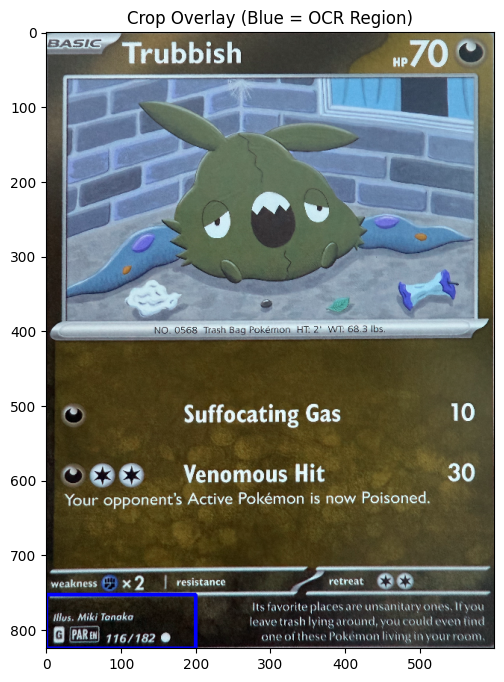

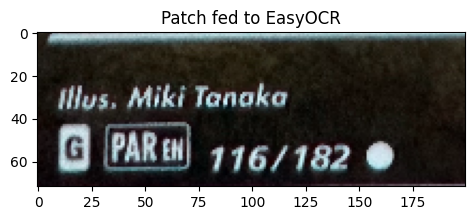

[Reference OCR rejected] Set=sm4, ID=
DEBUG: EasyOCR raw: [([[15, 43], [241, 43], [241, 79], [15, 79]], '1566616', 0.18437726010161098), ([[61, 89], [119, 89], [119, 129], [61, 129]], '6', 0.1448456567301415), ([[157, 97], [299, 97], [299, 137], [157, 137]], '116/182', 0.9950940571874985)]
DEBUG: Candidate: 1566616 Conf: 0.18437726010161098
DEBUG: Candidate: 6 Conf: 0.1448456567301415
DEBUG: Candidate: 116/182 Conf: 0.9950940571874985
DEBUG: Matched regex: 116
[Fallback OCR succeeded] Set=sm4, ID=116
Extracted Pokémon ID: 116


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [17]:
import cv2
import numpy as np
from PIL import Image
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.text_detection import get_pokeid

img_path = "../../images_example/IMG_9429.jpg"
set_id = "sm4"  # Use ground-truth for debugging!

# 1. Load & align the card
pil_img = Image.open(img_path).convert("RGB")
aligned_img = deform_card(pil_img)

# 2. ALWAYS resize to standard (600x825) for cropping!
if aligned_img.shape[:2] != (825, 600):
    aligned_img = cv2.resize(aligned_img, (600, 825))

# (Optional) Visualize the patch
patch = visualize_id_crop(aligned_img, set_id)  # Returns the cropped region for inspection

# 3. OCR: Pass the FULL aligned, resized image & set_id
pokeid = get_pokeid(aligned_img, set_id)
print(f"Extracted Pokémon ID: {pokeid}")


In [19]:
import numpy as np
import cv2
from PIL import Image
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
from Pokemon_Core.Image_Module.text_detection import get_pokeid
from Pokemon_Core.Image_Module.prediction import get_card_info

def recognize_card_from_photo(
    img_path,
    model_left, le_left,
    model_right, le_right,
    show_images=True,
    show_crop=True
):
    """
    Full pipeline: set prediction (both sides), card number OCR, and API lookup.
    Uses the full aligned card image for get_pokeid, matching notebook workflow.
    """
    # Load & align card
    pil_img = Image.open(img_path).convert("RGB")
    aligned_img = deform_card(pil_img)

    if show_images:
        import matplotlib.pyplot as plt
        plt.figure(figsize=(6, 6))
        plt.imshow(aligned_img)
        plt.axis("off")
        plt.title("Aligned Card Image")
        plt.show()

    # Get bottom corners for prediction
    graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

    # Preprocess for MobileNetV2
    def preprocess_region(region):
        region = np.squeeze(region)
        if region.ndim == 3 and region.shape[-1] == 1:
            region = region[..., 0]
        region = cv2.resize(region, (160, 160))
        region = region.astype('float32')  # DO NOT divide by 255 for your model!
        region = np.expand_dims(region, axis=-1)
        region = np.repeat(region, 3, axis=-1)
        region = np.expand_dims(region, axis=0)
        return region

    region_left = preprocess_region(graybottomleft)
    region_right = preprocess_region(graybottomright)

    # Predict with both models
    pred_left = model_left.predict(region_left)
    pred_right = model_right.predict(region_right)

    set_left = le_left.inverse_transform([np.argmax(pred_left)])[0]
    set_right = le_right.inverse_transform([np.argmax(pred_right)])[0]

    conf_left = np.max(pred_left)
    conf_right = np.max(pred_right)

    print(f"Left pred: {set_left} (conf: {conf_left:.2f})")
    print(f"Right pred: {set_right} (conf: {conf_right:.2f})")

    # Pick set_id (your original logic)
    set_id, used_side = None, None
    if set_left == "no" and set_right == "no":
        print("❗ No set detected with either model. Please try another image.")
        return None
    elif set_left != "no" and set_right != "no":
        print("⚠️ Both models detected a set. Using higher confidence prediction.")
        if conf_left >= conf_right:
            set_id, used_side = set_left, "left"
        else:
            set_id, used_side = set_right, "right"
    elif set_right == "no":
        set_id, used_side = set_left, "left"
    elif set_left == "no":
        set_id, used_side = set_right, "right"

    print(f"Selected set: {set_id} (side: {used_side})")

    # --- RESIZE to standard (600x825) for OCR ---
    card_for_ocr = np.array(aligned_img)
    if card_for_ocr.shape[:2] != (825, 600):
        card_for_ocr = cv2.resize(card_for_ocr, (600, 825))

    # (Optional) Visualize patch for debugging
    def visualize_id_crop(card_img, set_id):
        # If your card is not 600x825, resize to standard
        img = cv2.resize(card_img, (600, 825))
        a, b, c, d = get_id_coords(set_id, img.shape)
        # Draw rectangle on a copy for visualization
        vis_img = img.copy()
        cv2.rectangle(vis_img, (a, b), (c, d), (255,0,0), 3)
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(vis_img, cv2.COLOR_BGR2RGB))
        plt.title("Crop Overlay (Blue = OCR Region)")
        plt.show()
        # Show the actual cropped patch
        crop = img[b:d, a:c]
        plt.figure(figsize=(6,2))
        plt.imshow(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
        plt.title("Patch fed to EasyOCR")
        plt.show()
        return crop  # You can pass this to your ocr_preprocessor if you want

    if show_crop:
        _ = visualize_id_crop(card_for_ocr, set_id)

    # OCR: Pass full aligned, resized image & set_id
    pokeid = get_pokeid(card_for_ocr, set_id)
    print(f"Extracted Pokémon ID: {pokeid}")

    # Fetch info from API
    info = get_card_info(set_id, pokeid)
    if info is None or info[0] is None:
        print("⚠️  API lookup failed or card not found.")
    else:
        rarity, market_price, image_url = info
        print(f"Rarity:     {rarity}")
        print(f"Avg. Price: ${market_price}")
        print(f"Image URL:  {image_url}")

    return {
        "set_id": set_id,
        "side": used_side,
        "poke_id": pokeid,
        "rarity": info[0] if info else None,
        "market_price": info[1] if info else None,
        "image_url": info[2] if info else None
    }


In [21]:
import numpy as np
import cv2
from PIL import Image
from Pokemon_Core.Image_Module.deformer import deform_card
from Pokemon_Core.Image_Module.prediction import card_prediction_processing, cfg
from Pokemon_Core.Image_Module.text_detection import get_pokeid, get_id_coords
from Pokemon_Core.Image_Module.prediction import get_card_info



def recognize_card_from_photo(
    img_path,
    model_left, le_left,
    model_right, le_right,
    show_images=True,
    show_crop=True,
    use_tight_ocr_crop=True  # <-- new argument!
):

    """
    Full pipeline: set prediction (both sides), card number OCR (tight crop), and API lookup.
    """
    import matplotlib.pyplot as plt

    # Load & align card
    pil_img = Image.open(img_path).convert("RGB")
    aligned_img = deform_card(pil_img)

    if show_images:
        plt.figure(figsize=(6, 6))
        plt.imshow(aligned_img)
        plt.axis("off")
        plt.title("Aligned Card Image")
        plt.show()

    # Get bottom corners for prediction
    graybottomleft, graybottomright = card_prediction_processing(aligned_img, cfg)

    # Preprocess for MobileNetV2
    def preprocess_region(region):
        region = np.squeeze(region)
        if region.ndim == 3 and region.shape[-1] == 1:
            region = region[..., 0]
        region = cv2.resize(region, (160, 160))
        region = region.astype('float32')
        region = np.expand_dims(region, axis=-1)
        region = np.repeat(region, 3, axis=-1)
        region = np.expand_dims(region, axis=0)
        return region

    region_left = preprocess_region(graybottomleft)
    region_right = preprocess_region(graybottomright)

    # Predict with both models
    pred_left = model_left.predict(region_left)
    pred_right = model_right.predict(region_right)

    set_left = le_left.inverse_transform([np.argmax(pred_left)])[0]
    set_right = le_right.inverse_transform([np.argmax(pred_right)])[0]
    conf_left = np.max(pred_left)
    conf_right = np.max(pred_right)

    print(f"Left pred: {set_left} (conf: {conf_left:.2f})")
    print(f"Right pred: {set_right} (conf: {conf_right:.2f})")

    # Decide set_id
    set_id, used_side = None, None
    if set_left == "no" and set_right == "no":
        print("❗ No set detected with either model. Please try another image.")
        return None
    elif set_left != "no" and set_right != "no":
        print("⚠️ Both models detected a set. Using higher confidence prediction.")
        if conf_left >= conf_right:
            set_id, used_side = set_left, "left"
        else:
            set_id, used_side = set_right, "right"
    elif set_right == "no":
        set_id, used_side = set_left, "left"
    elif set_left == "no":
        set_id, used_side = set_right, "right"

    print(f"Selected set: {set_id} (side: {used_side})")

    # --- Resize to standard for OCR ---
    card_for_ocr = np.array(aligned_img)
    if card_for_ocr.shape[:2] != (825, 600):
        card_for_ocr = cv2.resize(card_for_ocr, (600, 825))

    # --- Optionally visualize the OCR region ---
    def visualize_id_crop(card_img, set_id, tight=False):
        img = cv2.resize(card_img, (600, 825))
        a, b, c, d = get_id_coords(set_id, img.shape, tight=True)
        vis_img = img.copy()
        cv2.rectangle(vis_img, (a, b), (c, d), (255,0,0), 3)
        plt.figure(figsize=(8, 8))
        plt.imshow(cv2.cvtColor(vis_img, cv2.COLOR_BGR2RGB))
        plt.title("Crop Overlay (Blue = OCR Region)")
        plt.show()
        crop = img[b:d, a:c]
        plt.figure(figsize=(6,2))
        plt.imshow(cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
        plt.title("Patch fed to EasyOCR")
        plt.show()
        return crop

    if show_crop:
        _ = visualize_id_crop(card_for_ocr, set_id, tight=use_tight_ocr_crop)

    # --- Use tight crop for EasyOCR ---
    a, b, c, d = get_id_coords(set_id, card_for_ocr.shape, tight=use_tight_ocr_crop)
    ocr_patch = card_for_ocr[b:d, a:c]
    pokeid = get_pokeid(ocr_patch, set_id)
    print(f"Extracted Pokémon ID: {pokeid}")

    # --- API lookup ---
    info = get_card_info(set_id, pokeid)
    if info is None or info[0] is None:
        print("⚠️  API lookup failed or card not found.")
    else:
        rarity, market_price, image_url = info
        print(f"Rarity:     {rarity}")
        print(f"Avg. Price: ${market_price}")
        print(f"Image URL:  {image_url}")

    return {
        "set_id": set_id,
        "side": used_side,
        "poke_id": pokeid,
        "rarity": info[0] if info else None,
        "market_price": info[1] if info else None,
        "image_url": info[2] if info else None
    }


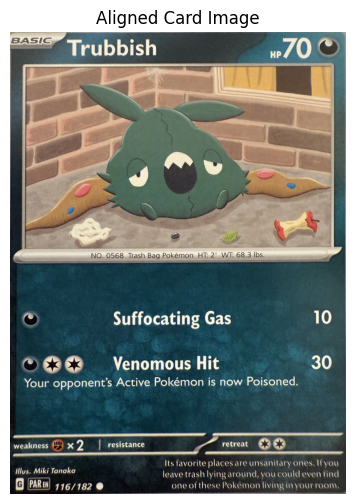

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
Left pred: sv3 (conf: 0.36)
Right pred: no (conf: 1.00)
Selected set: sv3 (side: left)


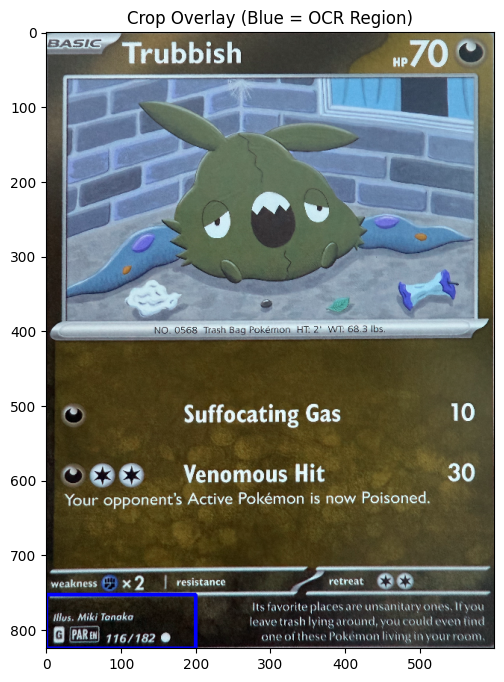

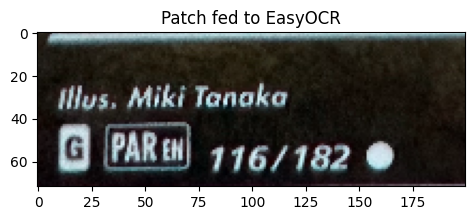

[Reference OCR succeeded] Set=sv3, ID=116
Extracted Pokémon ID: 116
Rarity:     Common
Avg. Price: $0.04
Image URL:  https://images.pokemontcg.io/sv3/116_hires.png


In [22]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9429.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)


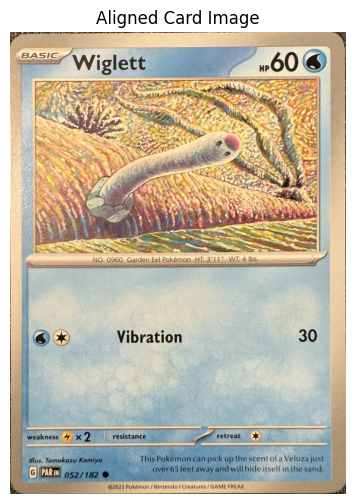

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
Left pred: sv3pt5 (conf: 1.00)
Right pred: no (conf: 1.00)
Selected set: sv3pt5 (side: left)


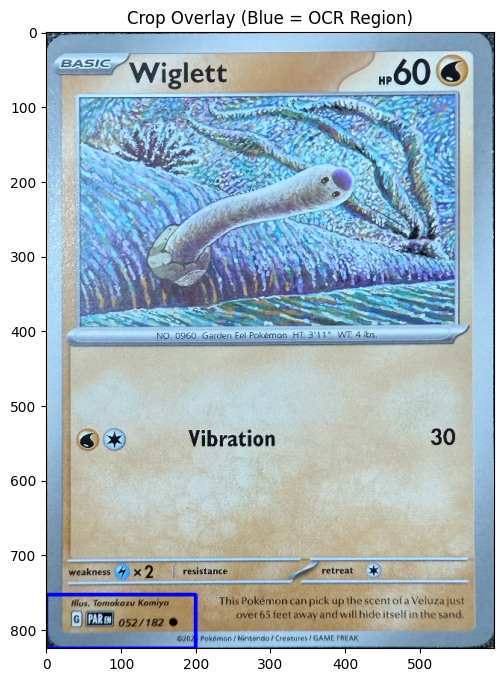

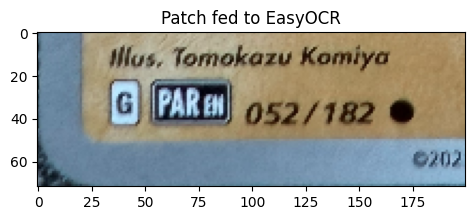

[Reference OCR rejected] Set=sv3pt5, ID=6205052
DEBUG: EasyOCR raw: [([[63, 6], [337, 6], [337, 43], [63, 43]], '10661//', 0.09771458957796461), ([[98, 42], [324, 42], [324, 96], [98, 96]], '60052/182', 0.5354222007742293), ([[349, 109], [399, 109], [399, 129], [349, 129]], '09', 0.2663368714798463)]
DEBUG: Candidate: 10661// Conf: 0.09771458957796461
DEBUG: Candidate: 60052/182 Conf: 0.5354222007742293
DEBUG: Matched regex: 052
[Fallback OCR succeeded] Set=sv3pt5, ID=52
Extracted Pokémon ID: 52
Rarity:     Common
Avg. Price: $0.04
Image URL:  https://images.pokemontcg.io/sv3pt5/52_hires.png


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [ ]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9431.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

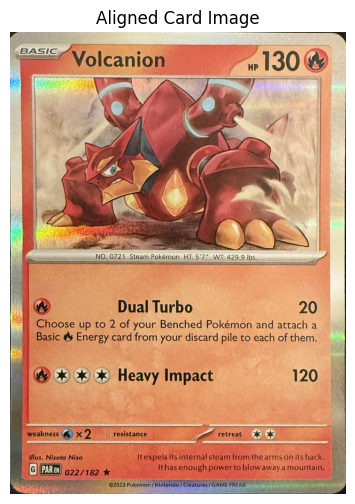

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Left pred: sv2 (conf: 0.52)
Right pred: no (conf: 1.00)
Selected set: sv2 (side: left)


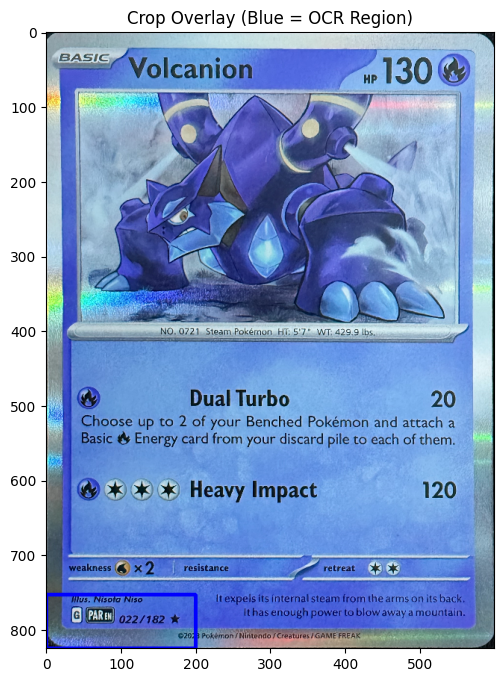

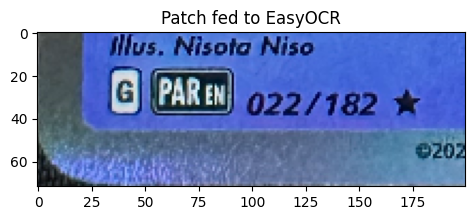

[Reference OCR rejected] Set=sv2, ID=55022
DEBUG: EasyOCR raw: [([[64, 0], [262, 0], [262, 26], [64, 26]], '1581550', 0.25561075899504804), ([[109, 39], [159, 39], [159, 75], [109, 75]], '/0', 0.025350432076061438), ([[193, 49], [325, 49], [325, 85], [193, 85]], '022/182', 0.9908399704856052), ([[350, 98], [400, 98], [400, 122], [350, 122]], '0202', 0.7121792435646057)]
DEBUG: Candidate: 1581550 Conf: 0.25561075899504804
DEBUG: Candidate: /0 Conf: 0.025350432076061438
DEBUG: Candidate: 022/182 Conf: 0.9908399704856052
DEBUG: Matched regex: 022
[Fallback OCR succeeded] Set=sv2, ID=22
Extracted Pokémon ID: 22
Rarity:     Common
Avg. Price: $0.03
Image URL:  https://images.pokemontcg.io/sv2/22_hires.png


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [24]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9434.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

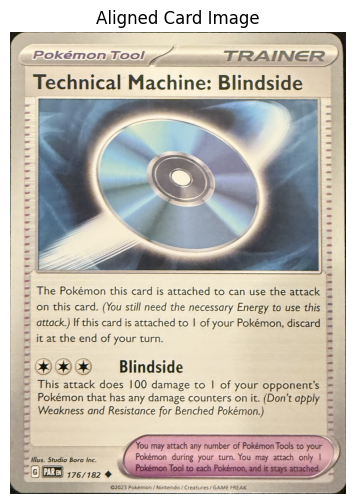

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
Left pred: sv4 (conf: 0.86)
Right pred: no (conf: 1.00)
Selected set: sv4 (side: left)


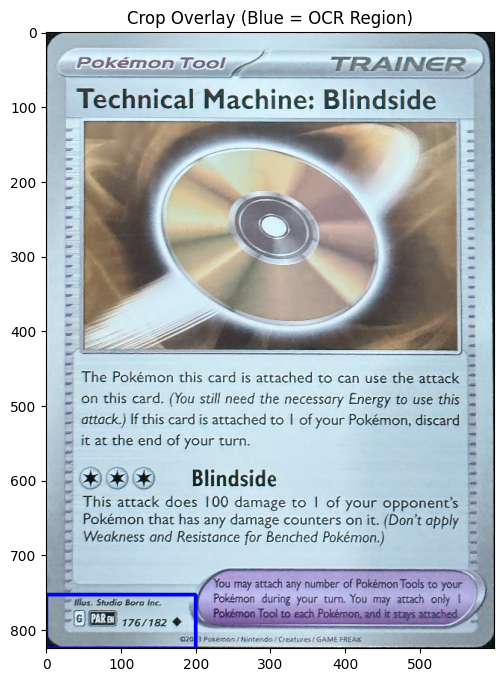

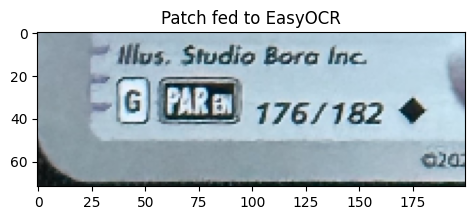

[Reference OCR rejected] Set=sv4, ID=6876
DEBUG: EasyOCR raw: [([[72, 8], [124, 8], [124, 34], [72, 34]], '03', 0.5506982569229742), ([[132, 8], [310, 8], [310, 34], [132, 34]], '881', 0.39568409891390094), ([[115, 47], [181, 47], [181, 83], [115, 83]], '', 0.0), ([[202, 60], [328, 60], [328, 92], [202, 92]], '176/182', 0.9976636852786386)]
DEBUG: Candidate: 03 Conf: 0.5506982569229742
DEBUG: Candidate: 881 Conf: 0.39568409891390094
DEBUG: Candidate:  Conf: 0.0
DEBUG: Candidate: 176/182 Conf: 0.9976636852786386
DEBUG: Matched regex: 176
[Fallback OCR succeeded] Set=sv4, ID=176
Extracted Pokémon ID: 176
Rarity:     Uncommon
Avg. Price: $0.04
Image URL:  https://images.pokemontcg.io/sv4/176_hires.png


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [25]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9435.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

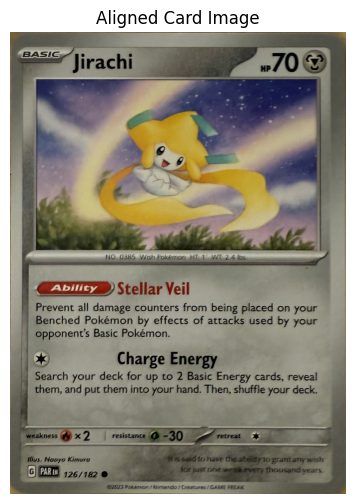

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
Left pred: sv4 (conf: 0.86)
Right pred: no (conf: 1.00)
Selected set: sv4 (side: left)


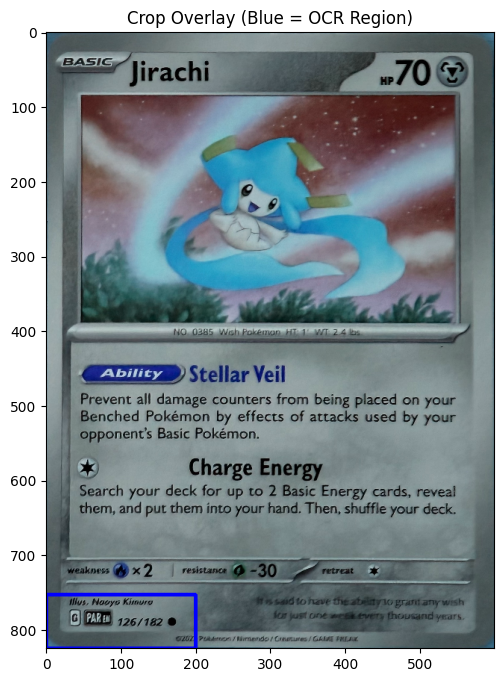

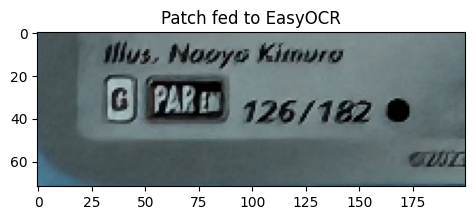

[Reference OCR succeeded] Set=sv4, ID=126
Extracted Pokémon ID: 126
Rarity:     Common
Avg. Price: $0.06
Image URL:  https://images.pokemontcg.io/sv4/126_hires.png


In [26]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9437.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

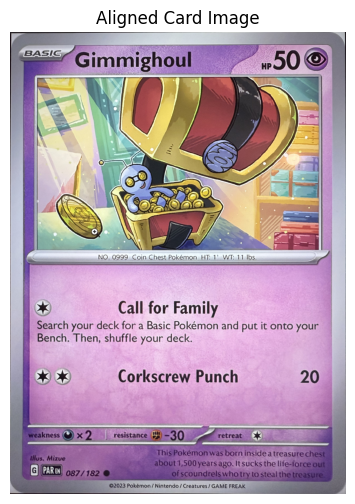

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Left pred: sv4 (conf: 0.96)
Right pred: no (conf: 1.00)
Selected set: sv4 (side: left)


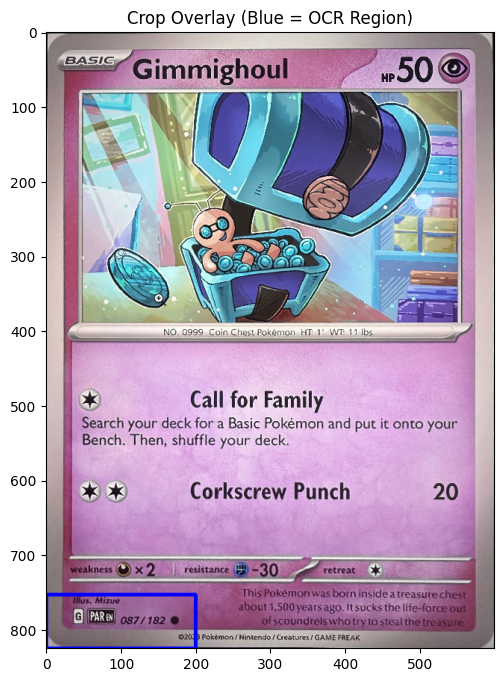

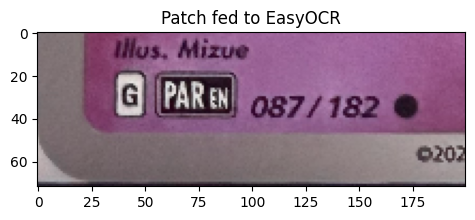

[Reference OCR rejected] Set=sv4, ID=19057
DEBUG: EasyOCR raw: [([[129, 1], [200, 1], [200, 31], [129, 31]], '65', 0.14447479583919587), ([[109, 41], [187, 41], [187, 79], [109, 79]], '6815', 0.05812953785061836), ([[196, 54], [254, 54], [254, 86], [196, 86]], '087/', 0.22964204847812653), ([[269, 53], [327, 53], [327, 89], [269, 89]], '182', 0.9999659314476219), ([[352, 102], [400, 102], [400, 126], [352, 126]], '0203', 0.47015559673309326)]
DEBUG: Candidate: 65 Conf: 0.14447479583919587
DEBUG: Candidate: 6815 Conf: 0.05812953785061836
DEBUG: Candidate: 087/ Conf: 0.22964204847812653
DEBUG: Candidate: 182 Conf: 0.9999659314476219
DEBUG: Candidate: 0203 Conf: 0.47015559673309326
DEBUG: Fallback runs: ['087', '1820203']
DEBUG: Longest run fallback: 203
[Fallback OCR succeeded] Set=sv4, ID=203
Extracted Pokémon ID: 203
Rarity:     Illustration Rare
Avg. Price: $5.75
Image URL:  https://images.pokemontcg.io/sv4/203_hires.png


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [27]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9398.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

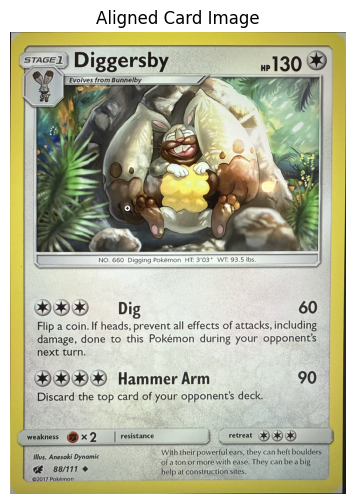

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Left pred: sm4 (conf: 0.95)
Right pred: no (conf: 1.00)
Selected set: sm4 (side: left)


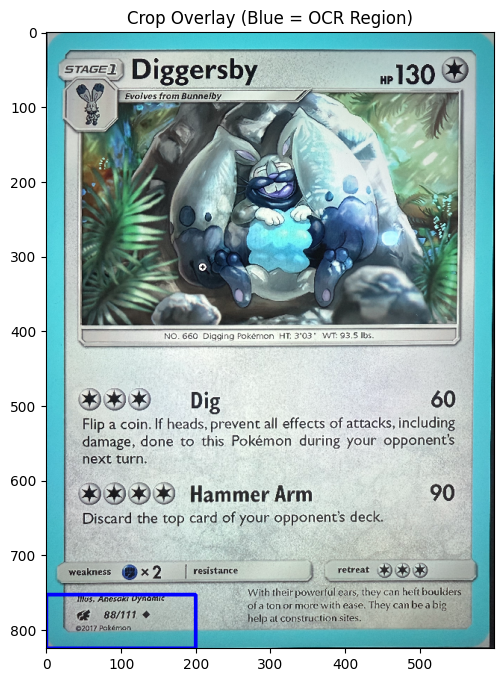

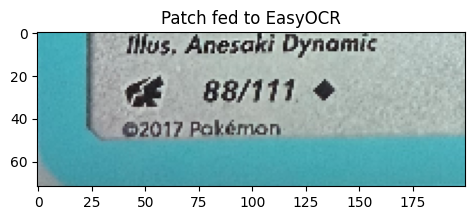

[Reference OCR succeeded] Set=sm4, ID=83
Extracted Pokémon ID: 83
Rarity:     Rare
Avg. Price: $1.05
Image URL:  https://images.pokemontcg.io/sm4/83_hires.png


In [28]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9399.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

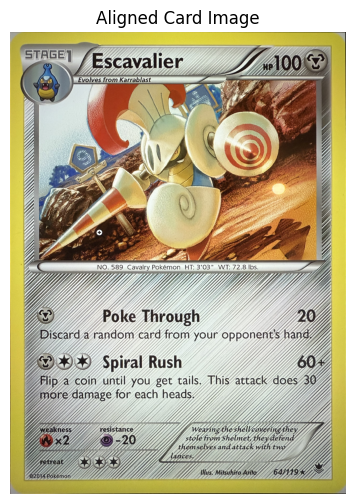

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Left pred: no (conf: 1.00)
Right pred: xy4 (conf: 0.52)
Selected set: xy4 (side: right)


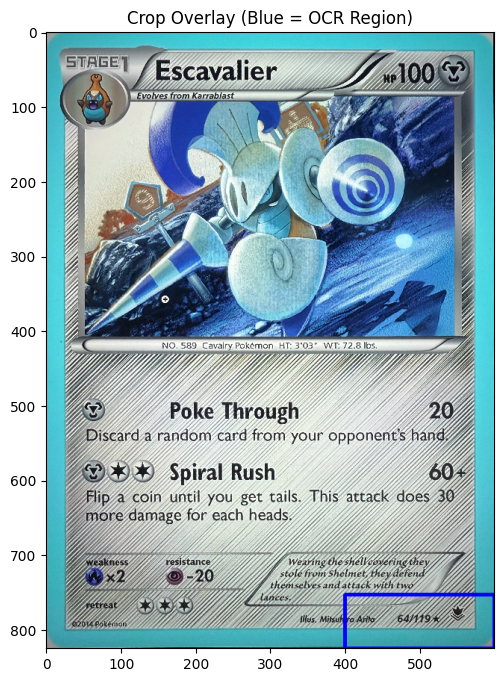

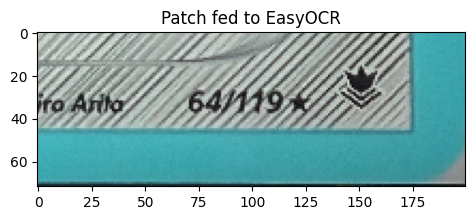

[Reference OCR rejected] Set=xy4, ID=
DEBUG: EasyOCR raw: []
DEBUG: Fallback runs: []
DEBUG: Fallback runs in blob: []
[Both OCR pipelines failed] Set=xy4, returning '0'
Extracted Pokémon ID: 0


HTTPError: 404 Client Error: Not Found for url: https://api.pokemontcg.io/v2/cards/xy4-0

In [29]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9400.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

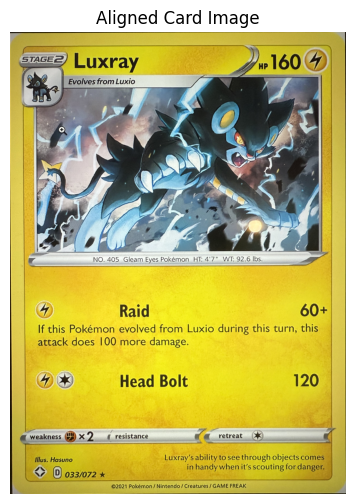

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
Left pred: swsh45 (conf: 1.00)
Right pred: no (conf: 1.00)
Selected set: swsh45 (side: left)


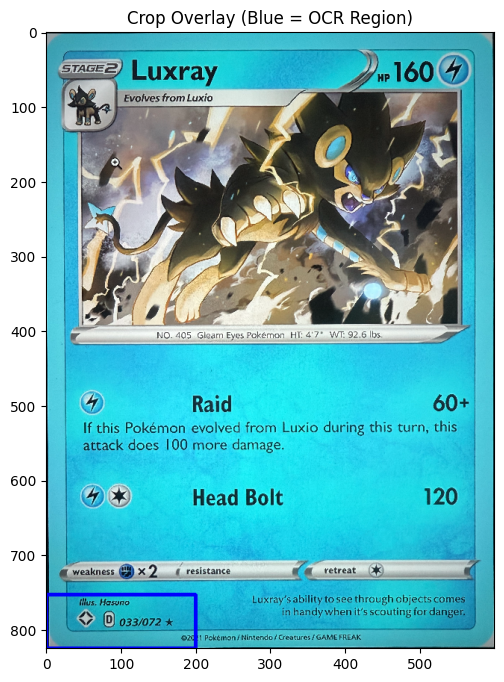

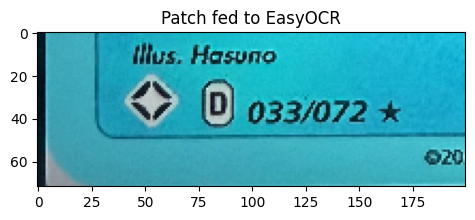

[Reference OCR rejected] Set=swsh45, ID=0033072
DEBUG: EasyOCR raw: [([[86, 6], [226, 6], [226, 34], [86, 34]], '85930', 0.19807693760667763), ([[193, 57], [315, 57], [315, 93], [193, 93]], '033/072', 0.6790357741904565)]
DEBUG: Candidate: 85930 Conf: 0.19807693760667763
DEBUG: Candidate: 033/072 Conf: 0.6790357741904565
DEBUG: Matched regex: 033
[Fallback OCR succeeded] Set=swsh45, ID=33
Extracted Pokémon ID: 33
Rarity:     Rare Holo
Avg. Price: $0.21
Image URL:  https://images.pokemontcg.io/swsh45/33_hires.png


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [30]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9401.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

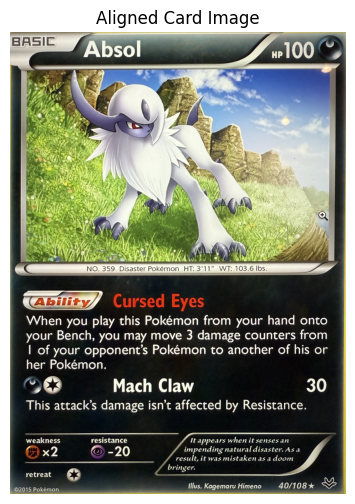

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
Left pred: no (conf: 0.98)
Right pred: xy6 (conf: 0.90)
Selected set: xy6 (side: right)


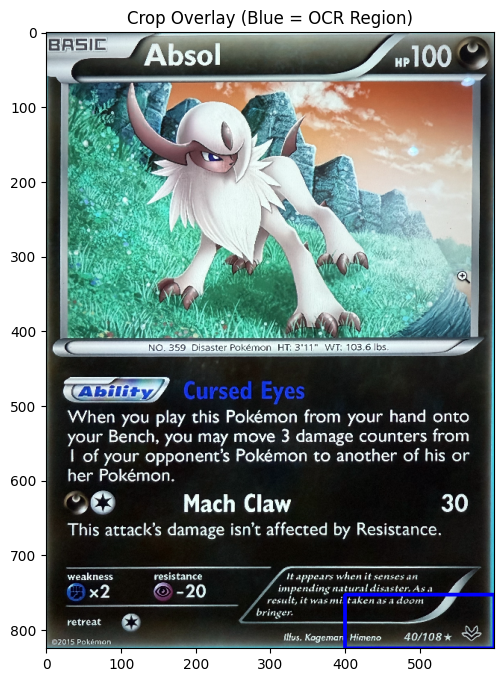

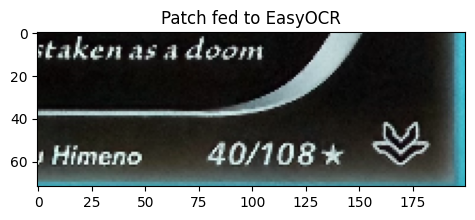

[Reference OCR rejected] Set=xy6, ID=
DEBUG: EasyOCR raw: [([[0, 0], [214, 0], [214, 32], [0, 32]], '/4848/', 0.09619931447769206), ([[9, 100], [103, 100], [103, 133], [9, 133]], '45', 0.3001599579702442), ([[155, 95], [293, 95], [293, 133], [155, 133]], '40/1081', 0.42628368406233336)]
DEBUG: Candidate: /4848/ Conf: 0.09619931447769206
DEBUG: Candidate: 45 Conf: 0.3001599579702442
DEBUG: Candidate: 40/1081 Conf: 0.42628368406233336
DEBUG: Matched regex: 40
[Fallback OCR succeeded] Set=xy6, ID=40
Extracted Pokémon ID: 40
Rarity:     Rare Holo
Avg. Price: $1.5
Image URL:  https://images.pokemontcg.io/xy6/40_hires.png


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


In [31]:
result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9402.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

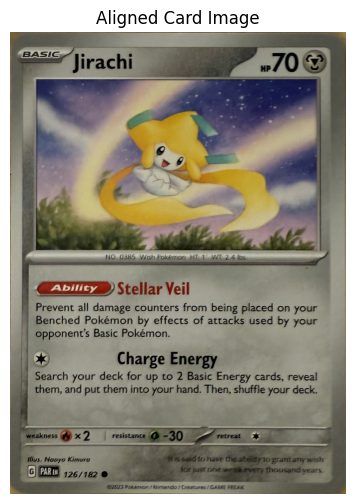

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Left pred: sv4 (conf: 0.86)
Right pred: no (conf: 1.00)
Selected set: sv4 (side: left)


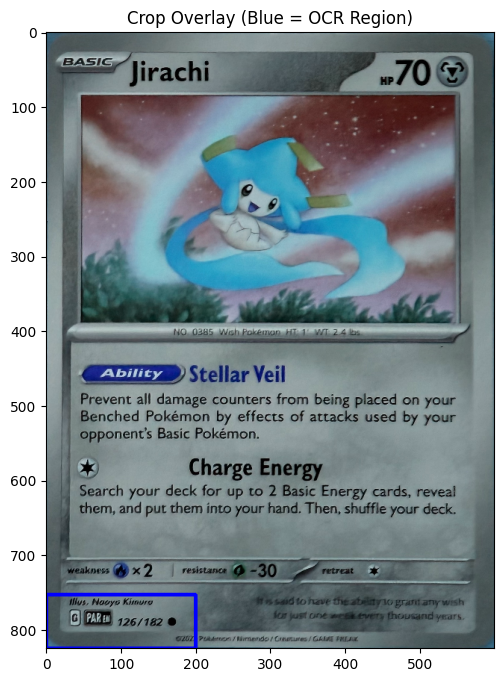

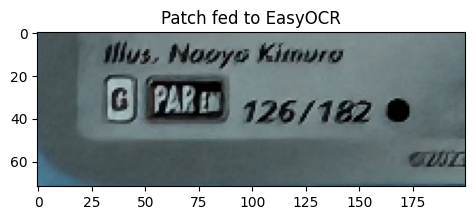

[Reference OCR succeeded] Set=sv4, ID=126
Extracted Pokémon ID: 126
Rarity:     Common
Avg. Price: $0.06
Image URL:  https://images.pokemontcg.io/sv4/126_hires.png


In [40]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9437.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

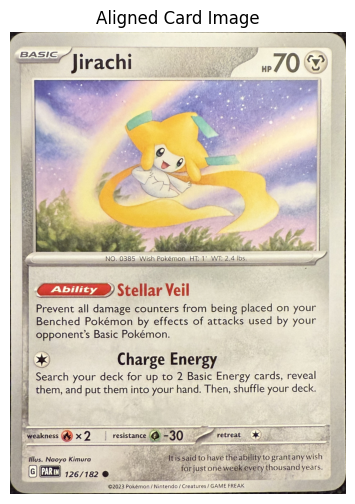

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
Left pred: sv3pt5 (conf: 0.98)
Right pred: no (conf: 1.00)
Selected set: sv3pt5 (side: left)


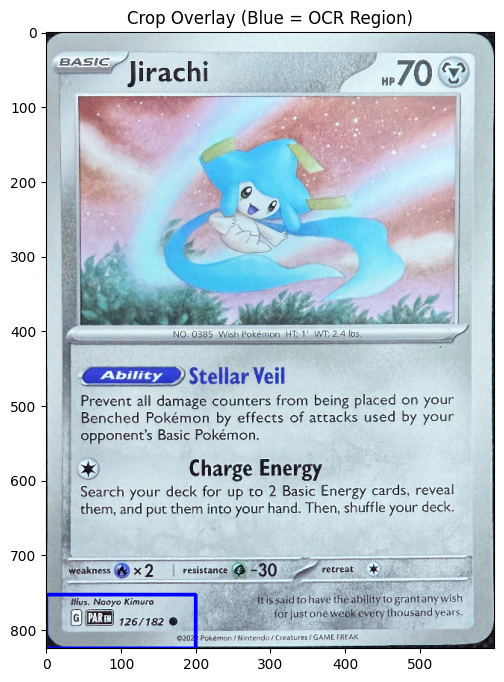

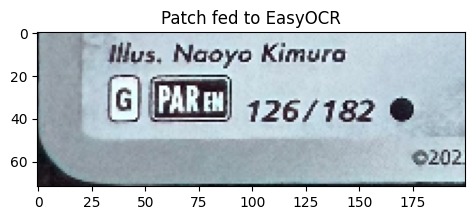

[Reference OCR succeeded] Set=sv3pt5, ID=126
Extracted Pokémon ID: 126
Rarity:     Common
Avg. Price: $0.04
Image URL:  https://images.pokemontcg.io/sv3pt5/126_hires.png


In [41]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9441 2.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

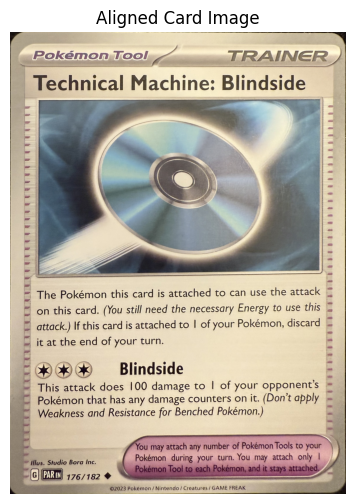

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
Left pred: sv3 (conf: 0.91)
Right pred: no (conf: 1.00)
Selected set: sv3 (side: left)


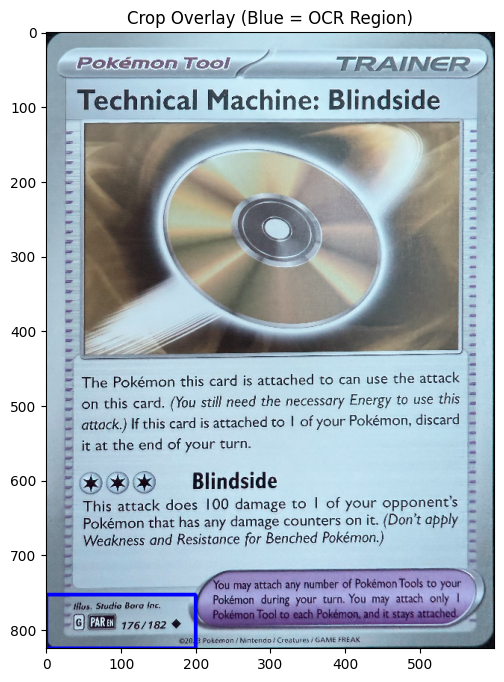

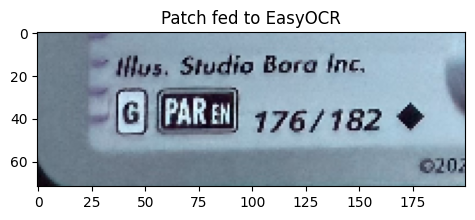

[Reference OCR rejected] Set=sv3, ID=5176


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


DEBUG: EasyOCR raw: [([[74, 16], [310, 16], [310, 48], [74, 48]], '8881', 0.2120012640953064), ([[113, 57], [329, 57], [329, 102], [113, 102]], '4480176/182', 0.29283523725717275)]
DEBUG: Candidate: 8881 Conf: 0.2120012640953064
DEBUG: Candidate: 4480176/182 Conf: 0.29283523725717275
DEBUG: Matched regex: 176
[Fallback OCR succeeded] Set=sv3, ID=176
Extracted Pokémon ID: 176
Rarity:     Common
Avg. Price: $0.05
Image URL:  https://images.pokemontcg.io/sv3/176_hires.png


In [42]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9442 2.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

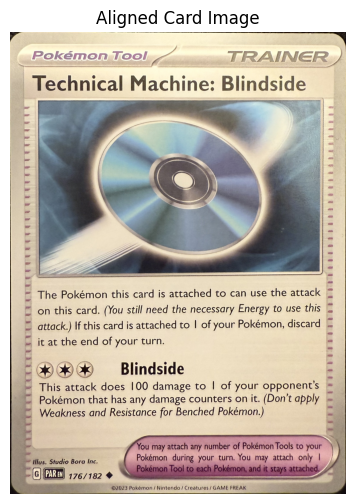

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
Left pred: sv4 (conf: 1.00)
Right pred: no (conf: 1.00)
Selected set: sv4 (side: left)


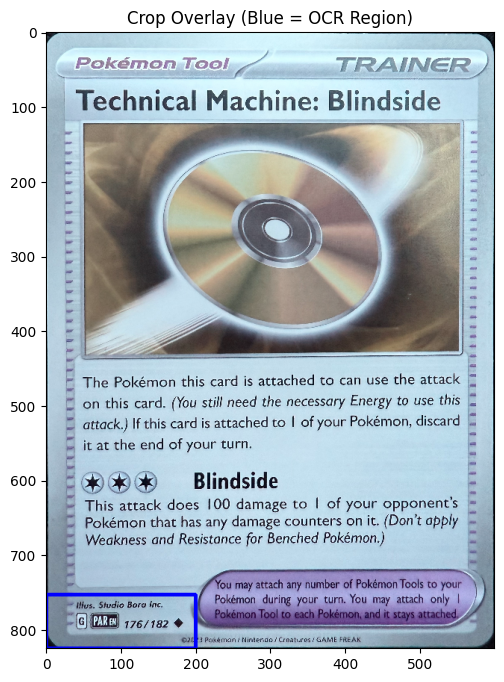

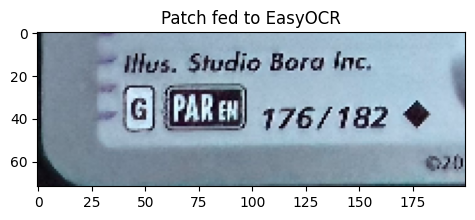

[Reference OCR succeeded] Set=sv4, ID=176
Extracted Pokémon ID: 176
Rarity:     Uncommon
Avg. Price: $0.04
Image URL:  https://images.pokemontcg.io/sv4/176_hires.png


In [43]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9443 2.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

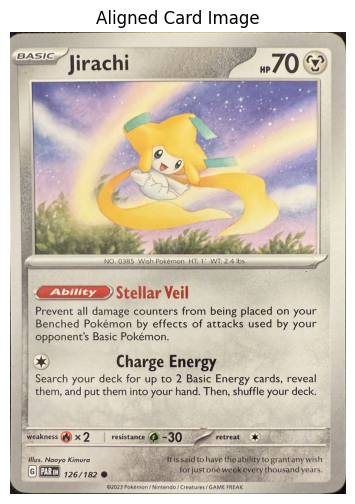

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
Left pred: sv3pt5 (conf: 0.70)
Right pred: no (conf: 1.00)
Selected set: sv3pt5 (side: left)


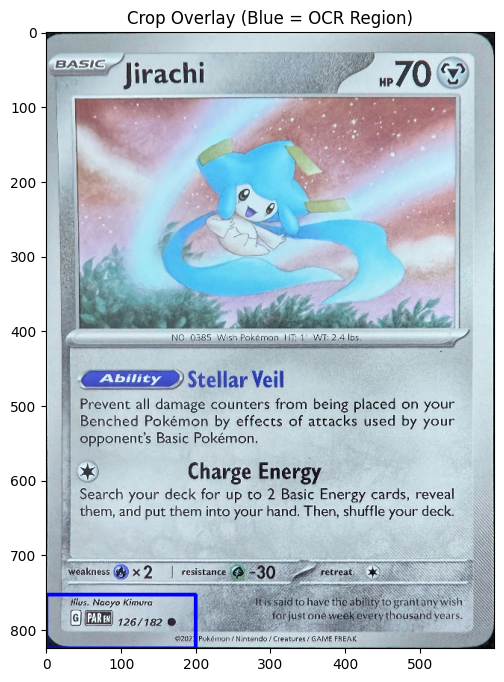

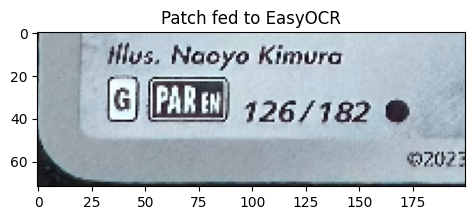

[Reference OCR succeeded] Set=sv3pt5, ID=126
Extracted Pokémon ID: 126
Rarity:     Common
Avg. Price: $0.04
Image URL:  https://images.pokemontcg.io/sv3pt5/126_hires.png


In [46]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9445 2.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

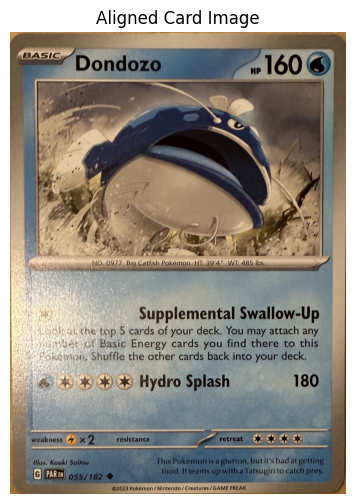

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 120ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
Left pred: swsh12pt5 (conf: 0.93)
Right pred: no (conf: 1.00)
Selected set: swsh12pt5 (side: left)


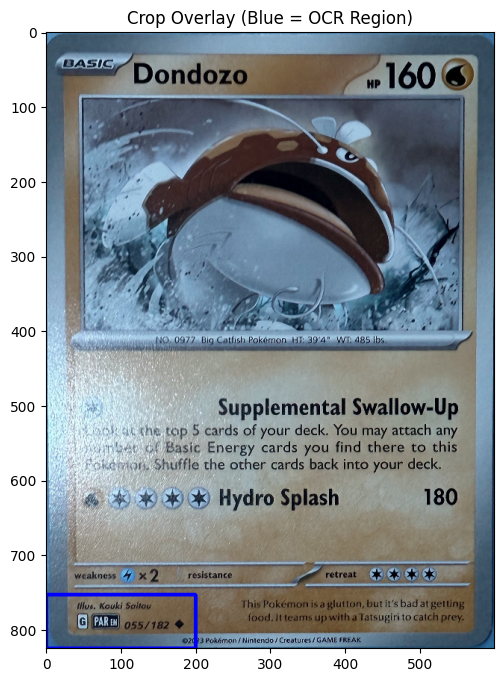

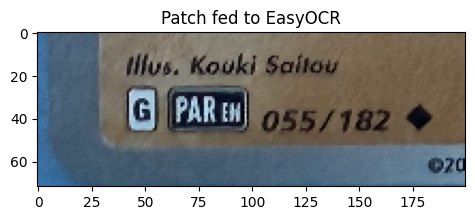

[Reference OCR rejected] Set=swsh12pt5, ID=5055


/Users/pavelsingh/.pyenv/versions/3.10.6/envs/Pokemon/lib/python3.10/site-packages/torch/utils/data/dataloader.py:683: UserWarning: 'pin_memory' argument is set as true but not supported on MPS now, then device pinned memory won't be used.
  warnings.warn(warn_msg)


DEBUG: EasyOCR raw: [([[80, 16], [262, 16], [262, 48], [80, 48]], '06688', 0.0769748422962977), ([[125, 55], [201, 55], [201, 91], [125, 91]], '41103', 0.029348222676218273)]
DEBUG: Candidate: 06688 Conf: 0.0769748422962977
DEBUG: Candidate: 41103 Conf: 0.029348222676218273
DEBUG: Fallback runs: []
DEBUG: Fallback runs in blob: ['6']
DEBUG: Longest run fallback in blob: 6
[Fallback OCR succeeded] Set=swsh12pt5, ID=6
Extracted Pokémon ID: 6
Rarity:     Common
Avg. Price: $0.03
Image URL:  https://images.pokemontcg.io/swsh12pt5/6_hires.png


In [64]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9412.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

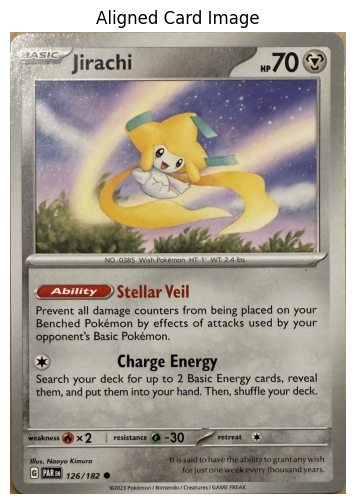

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 109ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
Left pred: sv2 (conf: 0.97)
Right pred: no (conf: 1.00)
Selected set: sv2 (side: left)


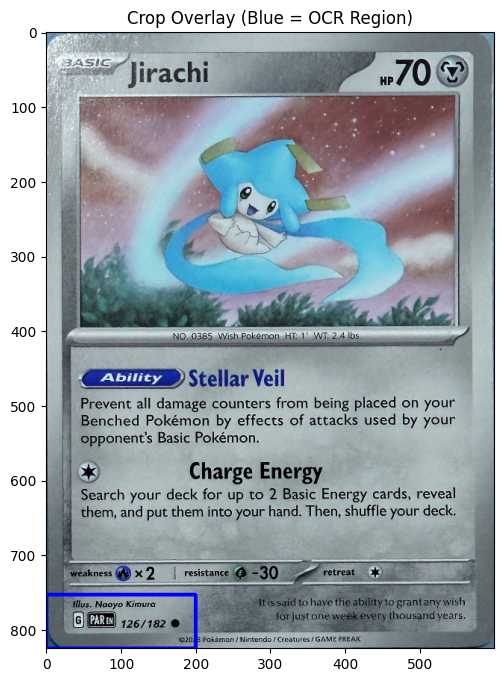

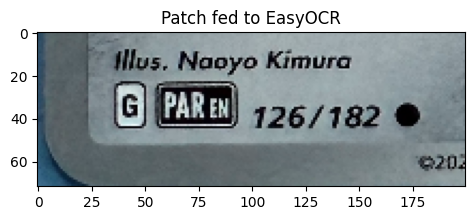

[Reference OCR succeeded] Set=sv2, ID=126
Extracted Pokémon ID: 126
Rarity:     Rare
Avg. Price: $0.06
Image URL:  https://images.pokemontcg.io/sv2/126_hires.png


In [65]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9467.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

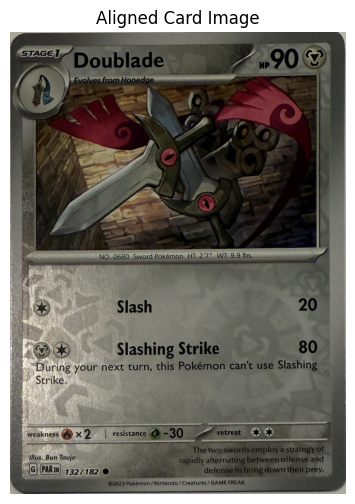

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 135ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
Left pred: sv3pt5 (conf: 0.89)
Right pred: no (conf: 1.00)
Selected set: sv3pt5 (side: left)


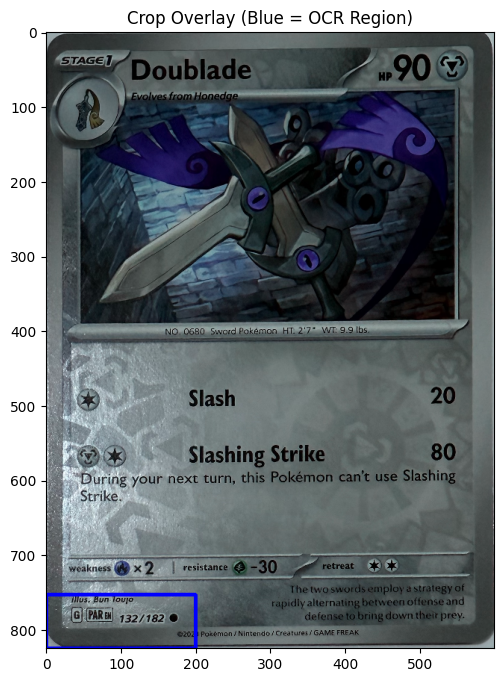

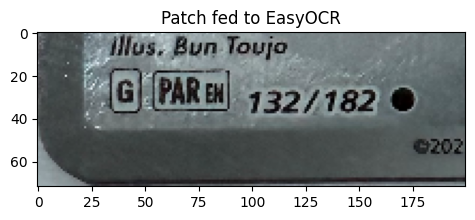

[Reference OCR succeeded] Set=sv3pt5, ID=432
Extracted Pokémon ID: 432


HTTPError: 404 Client Error: Not Found for url: https://api.pokemontcg.io/v2/cards/sv3pt5-432

In [66]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9405.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)

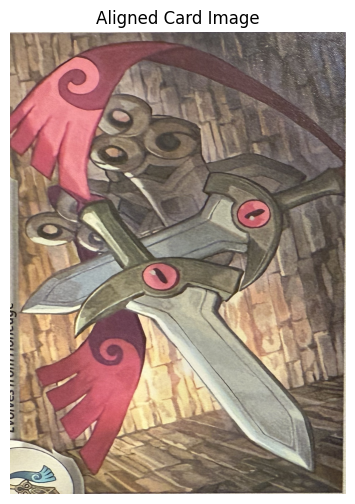

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step
Left pred: no (conf: 0.98)
Right pred: g1 (conf: 0.39)
Selected set: g1 (side: right)


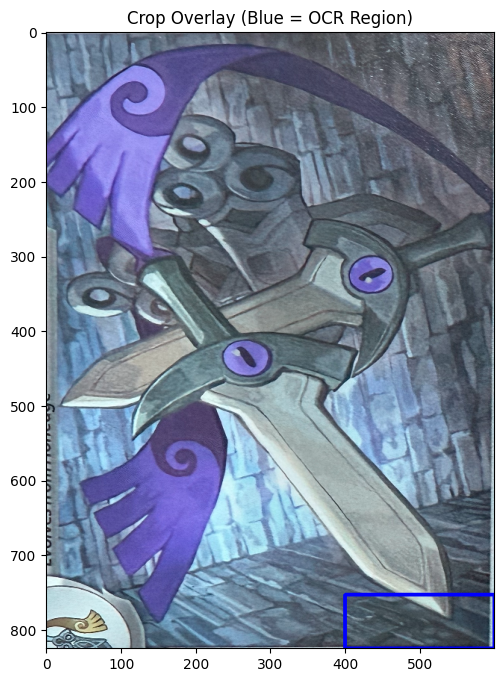

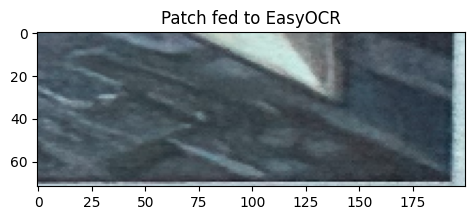

[Reference OCR rejected] Set=g1, ID=
DEBUG: EasyOCR raw: []
DEBUG: Fallback runs: []
DEBUG: Fallback runs in blob: []
[Both OCR pipelines failed] Set=g1, returning '0'
Extracted Pokémon ID: 0


HTTPError: 404 Client Error: Not Found for url: https://api.pokemontcg.io/v2/cards/g1-0

In [69]:
from Pokemon_Core.Image_Module.text_detection import get_id_coords

result = recognize_card_from_photo(
    img_path="../../images_example/IMG_9456.jpg",
    model_left=model_left, le_left=le_left,
    model_right=model_right, le_right=le_right,
    show_images=True,    # Show original card
    show_crop=True       # Show the region being OCR’d
)